#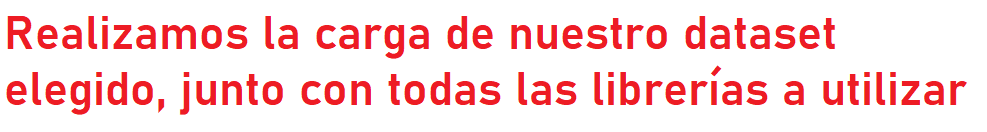

In [ ]:
import pandas as pd
from google.colab import drive
import os
drive.mount('/content/gdrive/')

Mounted at /content/gdrive/


In [ ]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.linear_model import LinearRegression
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_regression
from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import train_test_split
import plotly.express as px
import plotly.graph_objs as go
import plotly.offline as pyo
from plotly.subplots import make_subplots
from sklearn.cluster import KMeans
from sklearn.preprocessing import PolynomialFeatures
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import KBinsDiscretizer
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline
from sklearn.model_selection import cross_val_predict
from sklearn.model_selection import cross_val_score
from sklearn.metrics import davies_bouldin_score,silhouette_score,silhouette_samples,calinski_harabasz_score
from sklearn.preprocessing import StandardScaler
import matplotlib.cm as cm
from sklearn.decomposition import PCA
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import KFold
from sklearn.metrics import silhouette_samples, silhouette_score
import missingno as msno
%matplotlib inline

In [ ]:
pip install --upgrade pip

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 19.3 MB/s eta 0:00:00
  Attempting uninstall: pip
    Found existing installation: pip 23.1.2
    Uninstalling pip-23.1.2:
      Successfully uninstalled pip-23.1.2


In [ ]:
pip install scikit-learn --upgrade

  Obtaining dependency information for scikit-learn from https://files.pythonhosted.org/packages/5c/e9/ee572691a3fb05555bcde41826faad29ae4bc1fb07982e7f53d54a176879/scikit_learn-1.3.0-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.8/10.8 MB 68.3 MB/s eta 0:00:00
  Attempting uninstall: scikit-learn
    Found existing installation: scikit-learn 1.2.2
    Uninstalling scikit-learn-1.2.2:
      Successfully uninstalled scikit-learn-1.2.2


In [ ]:
import sklearn
print(sklearn.__version__)

1.2.2


In [ ]:
!pip install missingno

In [ ]:
!pip install pandas_profiling

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 324.4/324.4 kB 8.3 MB/s eta 0:00:00
  Obtaining dependency information for ydata-profiling from https://files.pythonhosted.org/packages/07/ba/f229e94517d033b427b3e856e1429872ce8368601ef534cad3c14a40f99e/ydata_profiling-4.3.1-py2.py3-none-any.whl.metadata
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 102.7/102.7 kB 8.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 679.5/679.5 kB 22.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 12.1 MB/s eta 0:00:00
  Obtaining dependency information for wordcloud>=1.9.1 from https://files.pythonhosted.org/packages/22/0d/bb4eccd60d272b33cbc79c661c60acc604f1688cfc922deb9d3eb5be640a/wordcloud-1.9.2-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata
  Obtaining dependency information for dacite>=1.8 from https://files.pythonhosted.org/packages/21/0f/cf0943f4f55f0fbc7c6bd60caf1343061dff818b02af5a0d444e473bb78d/d

In [ ]:
import pandas_profiling

<ipython-input-8-6a00893fb3e1>:1: DeprecationWarning:

`import pandas_profiling` is going to be deprecated by April 1st. Please use `import ydata_profiling` instead.



In [ ]:
import requests
import json
import pandas as pd

El dataset a analizar fue obtenido del sitio Kaggle.com, posee información sobre el consumo, producción, consumo per cápita, producción per cápita de gas natural, petróleo y carbón, por otro lado, cuenta con los nombres de los países tomados como muestreo junto con la población de cada uno con respecto a la variación anual. Nuestro análisis se basa principalmente en todas las variables relacionadas con el gas natural, el cual, es un recurso no renovable que presenta numerosas problemáticas en la actualidad. Durante el desarrollo de este notebook, haremos hincapié en las preguntas que motivaron nuestro interés por esta temática.

In [ ]:
%cd '/content/gdrive/MyDrive'
df= pd.read_csv('/content/gdrive/MyDrive/Fuel production vs consumption.csv', encoding="latin-1")
df.head

/content/gdrive/MyDrive


<bound method NDFrame.head of       Year                            Entity  Gas production(m³)  \
0     1980                       Afghanistan        1.699000e+09   
1     1981                       Afghanistan        2.237000e+09   
2     1982                       Afghanistan        2.294000e+09   
3     1983                       Afghanistan        2.407000e+09   
4     1984                       Afghanistan        2.407000e+09   
5     1985                       Afghanistan        2.974000e+09   
6     1986                       Afghanistan        2.974000e+09   
7     1987                       Afghanistan        2.804000e+09   
8     1988                       Afghanistan        3.002000e+09   
9     1989                       Afghanistan        2.945000e+09   
10    1990                       Afghanistan        2.945000e+09   
11    1991                       Afghanistan        3.115000e+08   
12    1992                       Afghanistan        3.000000e+08   
13    1993        

Consideramos que las audiencias a las que puede estar dirigido el siguiente trabajo pueden ser las siguientes:

* ***Tomadores de decisiones en la industria petroquímica***: incluyendo directivos de compañías gasíferas y de otras empresas
relacionadas con el petróleo y gas.
* ***Entes reguladores gubernamentales***: incluyendo agencias encargadas de supervisar la producción y el consumo de petróleo y
gas.
* ***Inversores***: incluyendo inversores institucionales y de capital de riesgo interesados en el sector petroquímico.
* ***Académicos y expertos en el sector energético***: incluyendo profesores y científicos que investigan y estudian la producción y el
consumo de gas.
urso, son menores. Evaluando lo anteriormente expuesto, realizaremos un comparativo y reflejaremos posibles hipótesis de por
que esto ocurre.


Nuestra meta es analizar los comportamientos
y relación entre la producción de gas y su consumo.
* ¿Los países que más producen gas, son a su vez los que mas lo consumen?
* Relación entre el consumo de gas y sus derivados con la población. ¿A mayor población habrá un mayor consumo?
* Comparando países desarrollados con países en desarrollo el primero cuenta con una baja densidad de población, pero, al mismo
tiempo tiene una producción muy alta de Y producto, en cambio, el segundo país mencionado, posee una densidad demográfica
mucho mayor, pero sus consumos de dicho recurso, son menores. Evaluando lo anteriormente expuesto, realizaremos un
comparativo y reflejaremos posibles hipótesis de por que esto ocurre.
* Teniendo en cuenta las variables como el aumento exponencial de la población, relacionado con la
producción y consumo, nuestra preocupación se centra en la posible escazes de gas, que es un
recurso natural no renovable, nos dedicaremos a analizar los últimos 10 años, quiénes fueron los
mayores productores y consumidores de este recurso. Haciendo un mayor hincapie en la hipótesis
sobre si lo producido alcanza a abastecer a la cada vez más vasta población.
Para desarrollar nuestro análisis partimos de las siguientes ***preguntas/hipótesis:***
* ¿La producción actual de gas, es suficiente para abastecer a la cada vez mayor población?
* Después de tantos años de explotación de este recurso natural, ¿Se logra conseguir cada vez menos
de él?
* Considerando la gran cantidad de productos eléctricos que se utilizan hoy en día, que
reemplazan el uso del gas, ¿En los últimos 10 años el consumo se redujo en consecuencia?
¿Quiénes son los mayores explotadores de gas a nivel mundial?
¿Quiénes son los mayores consumidores de gas a nivel mundial?

#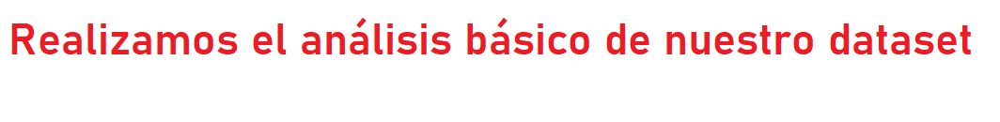

**Mostramos las primeras 10 filas**

In [ ]:
df.head(10)

,Year,Entity,Gas production(m³),Gas consumption(m³),Coal production(Ton),Coal consumption(Ton),Oil production(m³),Oil consumption(m³),Gas production per capita(m³),Gas consumption per capita(m³),Coal production per capita(Ton),Coal consumption per capita(Ton),Oil production per capita(m³),Oil consumption per capita(m³),Population
0,1980,Afghanistan,1.699000e+09,5.664000e+07,119000.0,119000.0,0.0,406500.0,127.2,4.241,0.00891,0.00891,0.0,0.03043,13360000.0
1,1981,Afghanistan,2.237000e+09,8.496000e+07,125000.0,125000.0,0.0,464600.0,169.9,6.450,0.00949,0.00949,0.0,0.03527,13170000.0
2,1982,Afghanistan,2.294000e+09,1.416000e+08,145000.0,145000.0,0.0,452900.0,178.1,10.990,0.01126,0.01126,0.0,0.03516,12880000.0
3,1983,Afghanistan,2.407000e+09,1.416000e+08,145000.0,145000.0,0.0,638800.0,192.0,11.290,0.01157,0.01157,0.0,0.05095,12540000.0
4,1984,Afghanistan,2.407000e+09,1.416000e+08,148000.0,148000.0,0.0,638800.0,197.2,11.600,0.01213,0.01213,0.0,0.05234,12200000.0
5,1985,Afghanistan,2.974000e+09,0.000000e+00,151000.0,151000.0,0.0,754900.0,249.1,0.000,0.01265,0.01265,0.0,0.06323,11940000.0
6,1986,Afghanistan,2.974000e+09,0.000000e+00,160000.0,160000.0,0.0,789600.0,253.4,0.000,0.01363,0.01363,0.0,0.06728,11740000.0
7,1987,Afghanistan,2.804000e+09,6.230000e+08,167000.0,167000.0,0.0,805300.0,241.6,53.690,0.01439,0.01439,0.0,0.06940,11600000.0
8,1988,Afghanistan,3.002000e+09,1.982000e+09,138000.0,138000.0,0.0,765700.0,258.4,170.600,0.01188,0.01188,0.0,0.06591,11620000.0
9,1989,Afghanistan,2.945000e+09,1.926000e+09,127000.0,127000.0,0.0,776600.0,248.2,162.300,0.01070,0.01070,0.0,0.06543,11870000.0


**Vemos que estructura tiene del dataset**

In [ ]:
df.shape

(9237, 15)

**Visualizamos la información sobre las columnas y tipos de datos**

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9237 entries, 0 to 9236
Data columns (total 15 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   Year                              9237 non-null   int64  
 1   Entity                            9237 non-null   object 
 2   Gas production(m³)                8708 non-null   float64
 3   Gas consumption(m³)               8689 non-null   float64
 4   Coal production(Ton)              8817 non-null   float64
 5   Coal consumption(Ton)             8817 non-null   float64
 6   Oil production(m³)                8792 non-null   float64
 7   Oil consumption(m³)               8555 non-null   float64
 8   Gas production per capita(m³)     7689 non-null   float64
 9   Gas consumption per capita(m³)    7671 non-null   float64
 10  Coal production per capita(Ton)   7757 non-null   float64
 11  Coal consumption per capita(Ton)  7757 non-null   float64
 12  Oil pr

**Cambiamos el nombre de dos columnas con el fin de que nos resulte mas sencillo trabajarlas**

In [ ]:
df = df.rename(columns={'Gas production(m³)': 'gasproduction', 'Gas consumption(m³)': 'gasconsumption'})

**Se muestran las columnas del dataset elegido**

In [ ]:
df.columns

Index(['Year', 'Entity', 'gasproduction', 'gasconsumption',
       'Coal production(Ton)', 'Coal consumption(Ton)', 'Oil production(m³)',
       'Oil consumption(m³)', 'Gas production per capita(m³)',
       'Gas consumption per capita(m³)', 'Coal production per capita(Ton)',
       'Coal consumption per capita(Ton)', 'Oil production per capita(m³)',
       'Oil consumption per capita(m³)', 'Population'],
      dtype='object')

**descripción estadística de los datos numéricos**

In [ ]:
df.describe()

,Year,gasproduction,gasconsumption,Coal production(Ton),Coal consumption(Ton),Oil production(m³),Oil consumption(m³),Gas production per capita(m³),Gas consumption per capita(m³),Coal production per capita(Ton),Coal consumption per capita(Ton),Oil production per capita(m³),Oil consumption per capita(m³),Population
count,9237.000000,8.708000e+03,8.689000e+03,8.817000e+03,8.817000e+03,8.792000e+03,8.555000e+03,7689.000000,7671.000000,7757.000000,7757.000000,7820.000000,7601.000000,8.132000e+03
mean,2000.443434,2.383023e+10,2.392419e+10,5.261801e+07,5.215915e+07,4.141132e+07,4.550758e+07,963.569615,612.621901,0.424189,0.434401,2.414781,1.392495,6.719422e+07
std,12.439275,1.896640e+11,1.891608e+11,4.355659e+08,4.349869e+08,2.901607e+08,3.268641e+08,4554.541934,2008.360465,1.577120,1.028148,11.332552,4.256257,4.709697e+08
min,1973.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,9.590000e+02
25%,1990.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,3.233000e+05,0.000000,0.000000,0.000000,0.000000,0.000000,0.152800,1.308750e+06
50%,2001.000000,0.000000e+00,0.000000e+00,0.000000e+00,1.221000e+03,0.000000e+00,1.568000e+06,0.000000,1.406000,0.000000,0.002069,0.000000,0.583400,6.651000e+06
75%,2011.000000,1.614000e+09,3.981000e+09,1.720000e+05,2.001000e+06,3.194000e+06,1.207000e+07,112.100000,450.500000,0.022110,0.254800,0.280250,1.650000,2.144750e+07
max,2021.000000,4.039000e+12,4.004000e+12,8.144000e+09,8.179000e+09,4.817000e+09,5.820000e+09,71520.000000,27160.000000,21.770000,7.093000,233.000000,125.800000,7.786000e+09


**Conteo de Valores por columna**

In [ ]:
df.count

<bound method DataFrame.count of       Year       Entity  gasproduction  gasconsumption  Coal production(Ton)  \
0     1980  Afghanistan   1.699000e+09      56640000.0              119000.0   
1     1981  Afghanistan   2.237000e+09      84960000.0              125000.0   
2     1982  Afghanistan   2.294000e+09     141600000.0              145000.0   
3     1983  Afghanistan   2.407000e+09     141600000.0              145000.0   
4     1984  Afghanistan   2.407000e+09     141600000.0              148000.0   
...    ...          ...            ...             ...                   ...   
9232  2017     Zimbabwe   0.000000e+00             0.0             2928000.0   
9233  2018     Zimbabwe   0.000000e+00             0.0             3348000.0   
9234  2019     Zimbabwe   0.000000e+00             0.0             3076000.0   
9235  2020     Zimbabwe   0.000000e+00             0.0             3659000.0   
9236  2021     Zimbabwe            NaN             NaN                   NaN   

      

**Tipos de datos por columna**

In [ ]:
df.dtypes

Year                                  int64
Entity                               object
gasproduction                       float64
gasconsumption                      float64
Coal production(Ton)                float64
Coal consumption(Ton)               float64
Oil production(m³)                  float64
Oil consumption(m³)                 float64
Gas production per capita(m³)       float64
Gas consumption per capita(m³)      float64
Coal production per capita(Ton)     float64
Coal consumption per capita(Ton)    float64
Oil production per capita(m³)       float64
Oil consumption per capita(m³)      float64
Population                          float64
dtype: object

**Estructura del dataset**

In [ ]:
type(df)

pandas.core.frame.DataFrame

**Principales medidas**

In [ ]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Year,9237.0,2.000443e+03,1.243928e+01,1973.0,1.990000e+03,2.001000e+03,2.011000e+03,2.021000e+03
gasproduction,8708.0,2.383023e+10,1.896640e+11,0.0,0.000000e+00,0.000000e+00,1.614000e+09,4.039000e+12
gasconsumption,8689.0,2.392419e+10,1.891608e+11,0.0,0.000000e+00,0.000000e+00,3.981000e+09,4.004000e+12
Coal production(Ton),8817.0,5.261801e+07,4.355659e+08,0.0,0.000000e+00,0.000000e+00,1.720000e+05,8.144000e+09
Coal consumption(Ton),8817.0,5.215915e+07,4.349869e+08,0.0,0.000000e+00,1.221000e+03,2.001000e+06,8.179000e+09
Oil production(m³),8792.0,4.141132e+07,2.901607e+08,0.0,0.000000e+00,0.000000e+00,3.194000e+06,4.817000e+09
Oil consumption(m³),8555.0,4.550758e+07,3.268641e+08,0.0,3.233000e+05,1.568000e+06,1.207000e+07,5.820000e+09
Gas production per capita(m³),7689.0,9.635696e+02,4.554542e+03,0.0,0.000000e+00,0.000000e+00,1.121000e+02,7.152000e+04
Gas consumption per capita(m³),7671.0,6.126219e+02,2.008360e+03,0.0,0.000000e+00,1.406000e+00,4.505000e+02,2.716000e+04
Coal production per capita(Ton),7757.0,4.241890e-01,1.577120e+00,0.0,0.000000e+00,0.000000e+00,2.211000e-02,2.177000e+01


#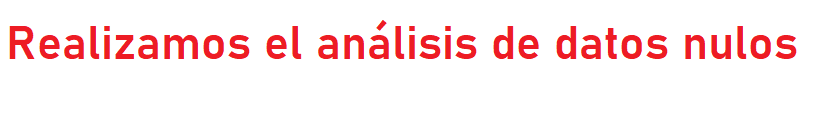

**Comenzamos el análisis de datos nulos y su respectivo reemplazo por cero**

In [ ]:
print(df.isnull().values.any())

True


**Conteo de valores nulos por columna**

In [ ]:
nulos = df.isnull().sum()

In [ ]:
print(nulos)

Year                                   0
Entity                                 0
gasproduction                        529
gasconsumption                       548
Coal production(Ton)                 420
Coal consumption(Ton)                420
Oil production(m³)                   445
Oil consumption(m³)                  682
Gas production per capita(m³)       1548
Gas consumption per capita(m³)      1566
Coal production per capita(Ton)     1480
Coal consumption per capita(Ton)    1480
Oil production per capita(m³)       1417
Oil consumption per capita(m³)      1636
Population                          1105
dtype: int64


**Se muestra el porcentaje de datos nulos**

In [ ]:
pd.set_option('display.max_rows', None)  # or 1000
serie=(df.isnull().sum()/df.shape[0])*100
serie=serie.sort_values(ascending=False)
serie= serie[serie>0]
serie

Oil consumption per capita(m³)      17.711378
Gas consumption per capita(m³)      16.953556
Gas production per capita(m³)       16.758688
Coal production per capita(Ton)     16.022518
Coal consumption per capita(Ton)    16.022518
Oil production per capita(m³)       15.340479
Population                          11.962758
Oil consumption(m³)                  7.383350
gasconsumption                       5.932662
gasproduction                        5.726968
Oil production(m³)                   4.817581
Coal production(Ton)                 4.546931
Coal consumption(Ton)                4.546931
dtype: float64

**Generamos un heatmap para visualizar los datos nulos o atípicos**

<Axes: title={'center': 'Heatmap datos nulos'}>

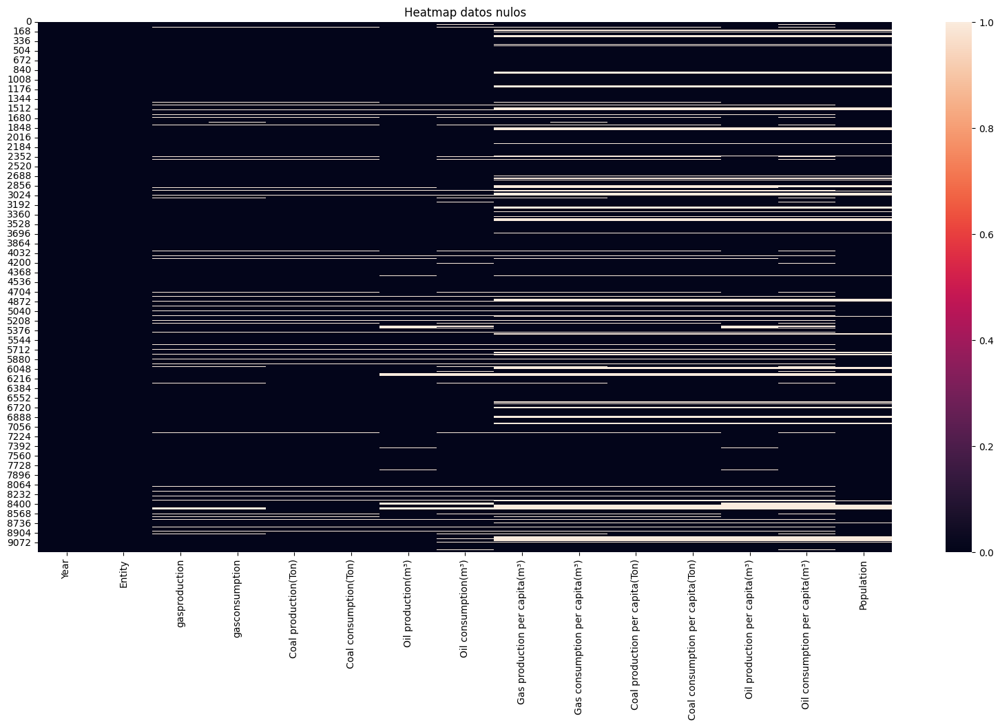

In [ ]:
fig, ax = plt.subplots(figsize=(20,10))
plt.title('Heatmap datos nulos')
sns.heatmap(df.isnull())

**Utilizamos la librería missingno para evaluar los datos nulos**

<Axes: >

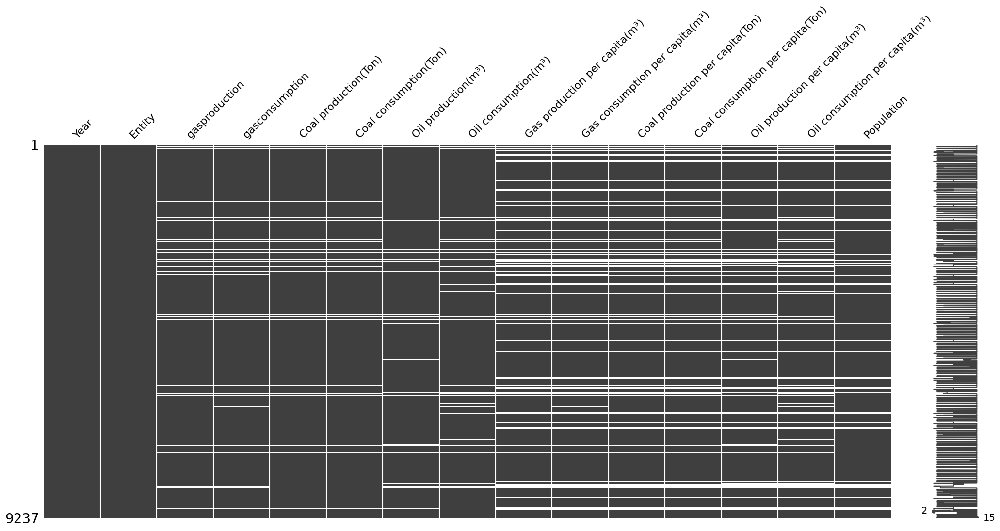

In [ ]:
msno.matrix(df)

**Generamos un gráfico de barras para visualizar los datos nulos**

In [ ]:
fig = go.Figure(
    go.Bar(
        x=nulos.values,
        y=nulos.index,
        orientation='h',
        text=nulos.values,
        textposition='inside'
    )
)

In [ ]:
fig.update_layout(
    title='Valores nulos por columna',
    xaxis_title='Cantidad de valores nulos',
    yaxis_title='Columnas',
    height=800,
)

fig.show()

En este primer gráfico que nos provee la librería Plotly permite ver de una forma visual la cantidad de valores nulos en un conjunto de datos. Analizando el mismo de nuestro dataset vemos que afortunadamente no hay mucha cantidad de datos nulos, el cual, a través de un reemplazo ya sea a 0 o por la media, reemplazar los valores nulos con ceros o la media debido a que se está trabajando con datos numéricos y se quiere hacer posteriormente una operación matemática que requiere que todos los valores sean numéricos. Esto hace que podamos analizar nuestro csv de manera más clara y así poder sacar conclusiones más consisas en el futuro.

**Buscamos si hay datos duplicados**

In [ ]:
duplicados = df.duplicated()
df_duplicados = df[duplicados]
print(df_duplicados)

Empty DataFrame
Columns: [Year, Entity, gasproduction, gasconsumption, Coal production(Ton), Coal consumption(Ton), Oil production(m³), Oil consumption(m³), Gas production per capita(m³), Gas consumption per capita(m³), Coal production per capita(Ton), Coal consumption per capita(Ton), Oil production per capita(m³), Oil consumption per capita(m³), Population]
Index: []


**Eliminamos los datos nulos**

In [ ]:
df.dropna(inplace=True)

**Comprobamos que no queden datos nulos**

In [ ]:
print(df.isnull().values.any())

False


#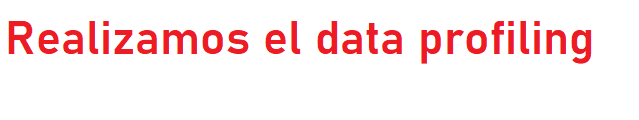

In [ ]:
profile = pandas_profiling.ProfileReport(df)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Este conjunto de datos contiene estadísticas sobre varias variables que proporcionan información sobre la producción y el consumo de varias fuentes de energía, incluyendo gas, carbón y petróleo en múltiples países desde 1980 hasta 2020. Las variables en este conjunto de datos están relacionadas con la producción y el consumo de energía en varios países a lo largo del tiempo. La variable "Entity" indica el país, mientras que "Year" indica el año en el que se recopilaron los datos.

Las demás variables numéricas proporcionan información sobre la producción y el consumo de varios tipos de energía, como gas, carbón y petróleo. Es posible que exista una relación positiva entre la producción y el consumo de energía en un país, lo que sugiere que cuanto más se produce, más se consume. Sin embargo, también es posible que existan diferencias entre países en términos de la forma en que utilizan la energía, lo que podría afectar la relación entre la producción y el consumo de energía.

También es importante tener en cuenta las limitaciones del conjunto de datos, como los valores faltantes y los posibles sesgos en los datos, al interpretar cualquier relación que se encuentre entre las variables. En resumen, el conjunto de datos podría ser útil para estudiar tendencias energéticas globales y comparar la producción y el consumo de energía entre países, pero se deben tener en cuenta las limitaciones y las posibles limitaciones de la interpretación de los datos.

#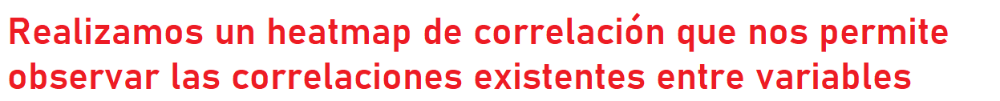

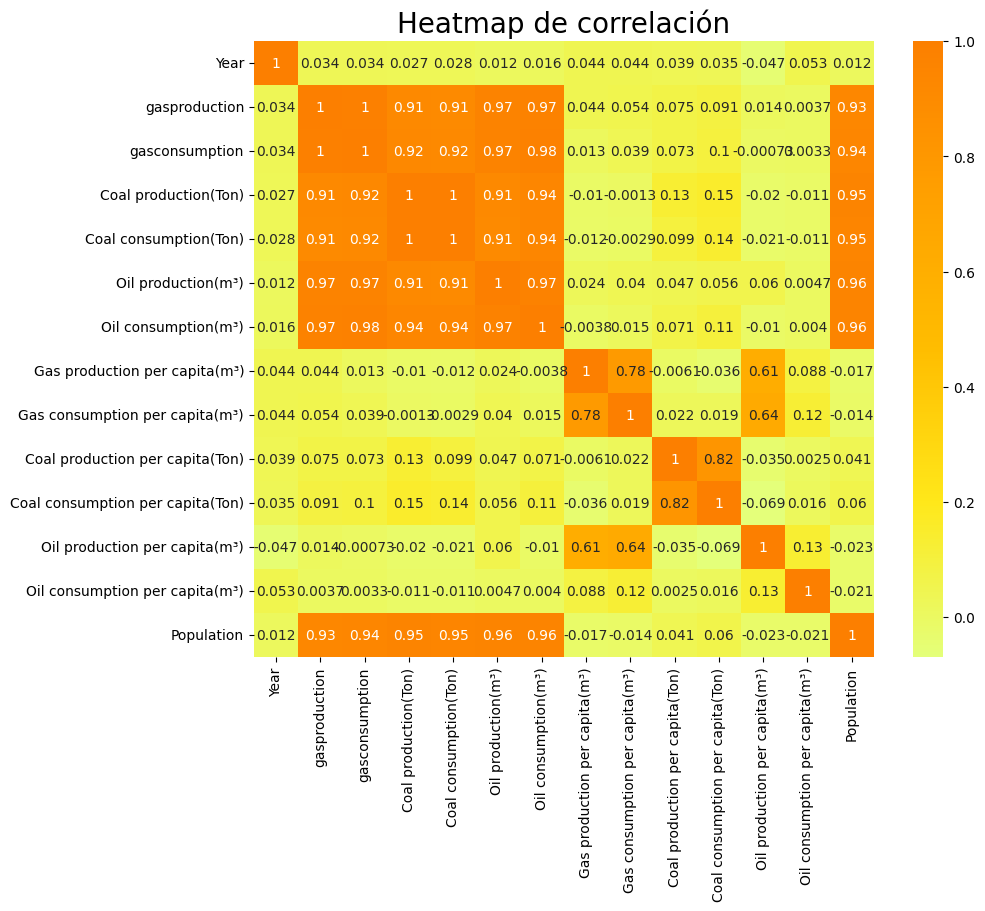

In [ ]:
numeric_cols = df.loc[:, df.dtypes != object]
plt.rcParams['figure.figsize'] = (10, 8)
sns.heatmap(numeric_cols.corr(), annot = True, cmap = 'Wistia')
plt.title('Heatmap de correlación', fontsize = 20)
plt.show()

En este mapa de calor, estamos comparando las relaciones entre variables, en este gráfico podemos ver la alta relación entre consumo y producción de gas, aunque también, no se debe desestimar el consumo como también la producción de los demás hidrocarburos. También podemos ver una alta relación con la variable "Population" que indica la población de cada país, lo cual nos hace pensar que a mayor población mayor, consumo/producción.

#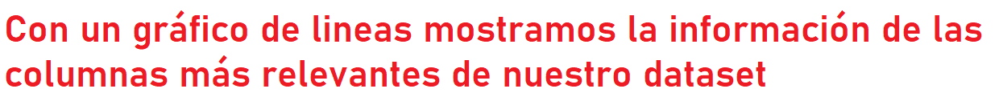

**Se filtran todos los registros que sean igual a 'World'**

In [ ]:
df_mundo = df[df['Entity'] == 'World']

Esto se realiza, debido a que los datos contenidos de este registro hace un suma general del mundo o "resto del mundo", y no analiza por un país en concreto, lo que hace que tengamos que desestimarlo debido a que puede arrojar datos atípicos o acumulados (valores muy grandes) que puede afectar a nuestros posteriores análisis, varianzas o desvío estándar que podamos realizar más adelante.

**Se filtran para observar las últimas 6 filas**

In [ ]:
df_mundo.tail(6)

,Year,Entity,gasproduction,gasconsumption,Coal production(Ton),Coal consumption(Ton),Oil production(m³),Oil consumption(m³),Gas production per capita(m³),Gas consumption per capita(m³),Coal production per capita(Ton),Coal consumption per capita(Ton),Oil production per capita(m³),Oil consumption per capita(m³),Population
9104,2014,World,3.493000e+12,3.494000e+12,8.046000e+09,8.076000e+09,4.555000e+09,5.422000e+09,478.9,479.0,1.1030,1.1070,0.6245,0.7434,7.294000e+09
9105,2015,World,3.553000e+12,3.543000e+12,7.864000e+09,7.822000e+09,4.692000e+09,5.526000e+09,481.5,480.1,1.0660,1.0600,0.6359,0.7489,7.378000e+09
9106,2016,World,3.590000e+12,3.620000e+12,7.390000e+09,7.616000e+09,4.696000e+09,5.608000e+09,481.0,485.1,0.9903,1.0210,0.6292,0.7515,7.463000e+09
9107,2017,World,3.703000e+12,3.736000e+12,7.604000e+09,7.691000e+09,4.716000e+09,5.731000e+09,490.6,495.0,1.0080,1.0190,0.6249,0.7594,7.547000e+09
9108,2018,World,3.906000e+12,3.923000e+12,7.903000e+09,7.800000e+09,4.817000e+09,5.789000e+09,512.4,514.6,1.0370,1.0230,0.6319,0.7595,7.623000e+09
9109,2019,World,4.039000e+12,4.004000e+12,8.025000e+09,7.681000e+09,4.771000e+09,5.820000e+09,524.2,519.7,1.0420,0.9968,0.6193,0.7554,7.705000e+09


**Se realizan los gráficos de lineas comparativos**

In [ ]:
fig = make_subplots(rows=3, cols=1, shared_xaxes=True,
                    subplot_titles=("Consumption", "Production", "Consumption per Capita vs Population"))

fig.add_trace(go.Scatter(x=df_mundo['Year'], y=df_mundo['gasconsumption'], name="Consumption", line=dict(color='red')), row=1, col=1)
fig.add_trace(go.Scatter(x=df_mundo['Year'], y=df_mundo['gasproduction'], name="Production", line=dict(color='green')), row=2, col=1)
fig.add_trace(go.Scatter(x=df_mundo['Year'], y=df_mundo['Population'], name="Population", line=dict(color='yellow')), row=3, col=1)

fig.update_xaxes(title_text="Year")

fig.update_yaxes(title_text="Gas consumption (m³)", row=1, col=1)
fig.update_yaxes(title_text="Gas production (m³)", row=2, col=1)
fig.update_yaxes(title_text="Gas consumption per capita (m³)", row=3, col=1)

fig.update_layout(title_text="Gas Production and Consumption", height=800)

fig.show()

En estos primeros gráficos luego de la limpieza de datos nulos, primeramente, hemos filtrado los datos englobados bajo la etiqueta "World" debido a que consideramos que esa categoría no representa a ningún país si no que son datos que toman al "resto del mundo" como un país, una vez realizado esto graficamos la sumatoria de consumo y por otro lado la de produción, lo cual, vemos que hay una tendencia al alza en todos los mismos. Por último en el tercer gráfico tenemos la relación entre el consumo per cápita y el crecimiento de la población, lo que podemos notar es que la línea es creciciente y recta, lo que podemos concluir que tenemos una relación directamente proporcional entre el consumo de gas y un aumento de la población, esto es, a más población más consumo.

#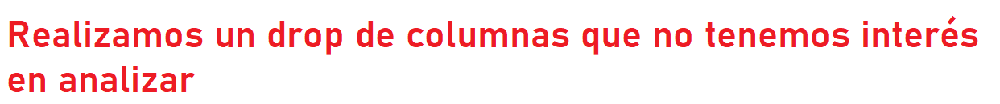

In [ ]:
columnas_a_eliminar = ['Coal consumption(Ton)','Coal production(Ton)','Oil production(m³)','Oil consumption(m³)','Oil production per capita(m³)','Coal consumption per capita(Ton)',
         'Coal production per capita(Ton)','Oil consumption per capita(m³)']
df = df.drop(columnas_a_eliminar, axis=1)

**Vemos el dataset luego del drop realizado**

In [ ]:
df.head

<bound method NDFrame.head of       Year                            Entity  gasproduction  gasconsumption  \
0     1980                       Afghanistan   1.699000e+09    5.664000e+07   
1     1981                       Afghanistan   2.237000e+09    8.496000e+07   
2     1982                       Afghanistan   2.294000e+09    1.416000e+08   
3     1983                       Afghanistan   2.407000e+09    1.416000e+08   
4     1984                       Afghanistan   2.407000e+09    1.416000e+08   
5     1985                       Afghanistan   2.974000e+09    0.000000e+00   
6     1986                       Afghanistan   2.974000e+09    0.000000e+00   
7     1987                       Afghanistan   2.804000e+09    6.230000e+08   
8     1988                       Afghanistan   3.002000e+09    1.982000e+09   
9     1989                       Afghanistan   2.945000e+09    1.926000e+09   
10    1990                       Afghanistan   2.945000e+09    1.897000e+09   
11    1991            

#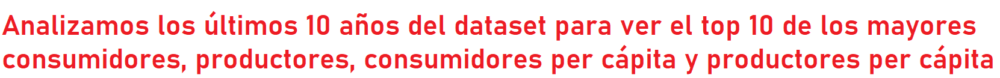

**Se muestran los ultimos 10 años del dataset**

In [ ]:
df2 = df[df['Year'] > 2010]

In [ ]:
df2

,Year,Entity,gasproduction,gasconsumption,Gas production per capita(m³),Gas consumption per capita(m³),Population
31,2011,Afghanistan,1.614000e+08,1.614000e+08,5.360000e+00,5.360000,3.012000e+07
32,2012,Afghanistan,1.603000e+08,1.603000e+08,5.145000e+00,5.145000,3.116000e+07
33,2013,Afghanistan,1.545000e+08,1.545000e+08,4.788000e+00,4.788000,3.227000e+07
34,2014,Afghanistan,1.419000e+08,1.419000e+08,4.253000e+00,4.253000,3.337000e+07
35,2015,Afghanistan,1.462000e+08,1.462000e+08,4.249000e+00,4.249000,3.441000e+07
36,2016,Afghanistan,1.653000e+08,1.653000e+08,4.672000e+00,4.672000,3.538000e+07
37,2017,Afghanistan,1.561000e+08,1.561000e+08,4.301000e+00,4.301000,3.630000e+07
38,2018,Afghanistan,1.532000e+08,1.532000e+08,4.122000e+00,4.122000,3.717000e+07
39,2019,Afghanistan,1.287000e+08,1.287000e+08,3.384000e+00,3.384000,3.804000e+07
73,2011,Albania,1.000000e+07,1.000000e+07,3.415000e+00,3.415000,2.929000e+06


**Se agrupan por país y se sacan los promedios de los últimos 10 años del dataset**

In [ ]:
df3 = df2.groupby('Entity').mean()

In [ ]:
df3

,Year,gasproduction,gasconsumption,Gas production per capita(m³),Gas consumption per capita(m³),Population
Entity,,,,,,
Afghanistan,2015.0,1.519556e+08,1.519556e+08,4.474889,4.474889,3.424667e+07
Albania,2015.0,3.255667e+07,3.255667e+07,11.263667,11.263667,2.896444e+06
Algeria,2015.0,8.720778e+10,3.924778e+10,2193.222222,983.611111,3.978333e+07
American Samoa,2014.0,0.000000e+00,0.000000e+00,0.000000,0.000000,7.619429e+04
Angola,2015.0,2.409611e+09,6.952778e+08,80.882222,24.803889,2.794111e+07
Antigua and Barbuda,2015.0,0.000000e+00,0.000000e+00,0.000000,0.000000,9.340444e+04
Argentina,2015.0,3.918556e+10,4.782778e+10,909.122222,1110.555556,4.306556e+07
Armenia,2015.0,0.000000e+00,2.341111e+09,0.000000,801.511111,2.920889e+06
Aruba,2014.0,0.000000e+00,0.000000e+00,0.000000,0.000000,1.043000e+05


**Se ordenen de manera descendente los paises según el consumo de gas promedio de los últimos 10 años**

In [ ]:
df_gas = df3.sort_values(by= ['gasconsumption'],ascending=False).head(11).iloc[1:]

In [ ]:
df_gas.head (10)

,Year,gasproduction,gasconsumption,Gas production per capita(m³),Gas consumption per capita(m³),Population
Entity,,,,,,
United States,2015.5,7.821600e+11,7.825700e+11,2426.500000,2430.100000,3.216900e+08
Russia,2015.5,6.324100e+11,4.645300e+11,4361.000000,3203.700000,1.450000e+08
China,2015.0,1.356000e+11,2.047000e+11,96.211111,145.080000,1.406111e+09
Iran,2015.0,1.906222e+11,1.854778e+11,2414.666667,2351.333333,7.861667e+07
Japan,2015.0,2.896667e+09,1.152333e+11,22.645556,901.033333,1.278667e+08
Canada,2015.0,1.728222e+11,1.140222e+11,4799.333333,3163.888889,3.600444e+07
Saudi Arabia,2015.0,1.033122e+11,1.033122e+11,3277.777778,3277.777778,3.151333e+07
Germany,2015.5,9.242600e+09,8.851200e+10,112.978000,1076.840000,8.215100e+07
United Kingdom,2015.0,4.130778e+10,7.780444e+10,627.888889,1181.888889,6.583444e+07


**Realizamos un gráfico de barras para mostrar los resultados**

In [ ]:
fig = go.Figure()
df_gas = df3.sort_values(by=['gasconsumption'], ascending=False).head(11).iloc[1:]
fig = make_subplots(rows=2, cols=1, shared_xaxes=True)
fig.add_trace(
    go.Bar(x=df_gas.index, y=df_gas['gasconsumption'], name='Consumo de gas', marker_color='green',
           text=["United States", "Russia", "China", "Iran", "Japon", "Canada", "Saudi Arabia", "Germany", "United Kingdom", "Mexico"]),
    row=1, col=1)
fig.update_yaxes(title_text='Consumo de gas', row=1, col=1)
fig.update_layout(title='Top 10 mayores consumidores de gas')
fig.update_layout(
    margin=dict(l=50, r=50, t=50, b=5))
fig.update_layout(margin=dict(l=0, r=0),height=300)
fig.show()

Luego de realizar los cambios correspondientes al dataset, y quedarnos con los datos que nos interesaban, pasamos a ver cuales son los 10 mayores consumidores de gas en el mundo, liderando el Ranking Estados Unidos, seguido a casi menos de la mitad de consumo de Rusia, y tercero China. Como podemos ver, una gran particularidad de estos países es que son fuertemente desarrollados (a excepcion de unos pocos), países en el mundo considerados "ricos" y, también, con fuertes industrias y fábricas donde el consumo de gas es imprescindible para llevar a cabo los intereses comerciales y de consumo que tiene cada país. Otra relación fuerte que se puede establecer es que son países muy poblados, con ciudades y metrópolis densamente pobladas, donde se hace inenudible un gran consumo y, donde está claro hay zonas fabriles de tamaños muy grandes.

**Se ordenen de manera descendente los paises según la producción de gas promedio de los últimos 10 años**

In [ ]:
df_gas_prod = df3.sort_values(by= ['gasproduction'],ascending=False).head(11).iloc[1:]

In [ ]:
df_gas_prod.head (10)

,Year,gasproduction,gasconsumption,Gas production per capita(m³),Gas consumption per capita(m³),Population
Entity,,,,,,
United States,2015.5,7.821600e+11,7.825700e+11,2426.500000,2430.100000,3.216900e+08
Russia,2015.5,6.324100e+11,4.645300e+11,4361.000000,3203.700000,1.450000e+08
Iran,2015.0,1.906222e+11,1.854778e+11,2414.666667,2351.333333,7.861667e+07
Canada,2015.0,1.728222e+11,1.140222e+11,4799.333333,3163.888889,3.600444e+07
Qatar,2015.0,1.618111e+11,3.761556e+10,64943.333333,15037.777778,2.509667e+06
China,2015.0,1.356000e+11,2.047000e+11,96.211111,145.080000,1.406111e+09
Norway,2015.5,1.140200e+11,4.651500e+09,21893.000000,895.450000,5.206800e+06
Saudi Arabia,2015.0,1.033122e+11,1.033122e+11,3277.777778,3277.777778,3.151333e+07
Algeria,2015.0,8.720778e+10,3.924778e+10,2193.222222,983.611111,3.978333e+07


**Realizamos el gráfico pertinente para visualizar los resultados obtenidos**

In [ ]:
fig = go.Figure()
fig = make_subplots(rows=2, cols=1, shared_xaxes=True)
fig.add_trace( go.Bar(x=df_gas.index, y=df_gas['gasproduction'], name='Producción de gas', marker_color='pink',
           text=["United States", "Russia", "Iran", "Canada", "Qatar", "China", "Norway", "Saudi Arabia", "Algeria", "Australia"])
           ,row=1, col=1)
fig.update_yaxes(title_text='Producción de gas', row=1, col=1)
fig.update_layout(title='Top 10 mayores productores de gas')
fig.update_layout(
    margin=dict(l=50, r=50, t=50, b=5))
fig.update_layout(margin=dict(l=0, r=0),height=300)
fig.show()


***Conclusion***

---


 ***Consumo vs Producción:*** Mirando los gráficos, podemos notar algunas diferencias,
por empezar que no todos los que más producen, lo consumen. Algunos de ellos, pueden tener una población menor, comercializarlo hacia otros países (que por no pueden explotar la extracción de este recurso, o bien, no se encuentra disponible dentro de su territorio para ser extraído), o bien pueden cubrir ambos mercados, el interno y externo. En el gráfico podemos observar también, cuáles son los dos mayores productores y consumidores, Estados Unidos y Rusia, que no es coincidencia que ambos sean de las principales potencias mundiales, y de los países mas ricos. Ambos tienen una densa población pero aún considerando eso, tienen capacidad de abastecerse, y comercializar el gas que extraen. Debemos tener en cuenta, de igual forma, que el gas es motivo de conflictos económicos, políticos, y bélicos, como es el caso de Rusia, que en el año 2006 atacó a Ucrania, porque se oponían a pagar la nueva tarifa impuesta por los rusos, cambiando así la tarifa que tenían pactada, que era menor. Teniendo en cuenta que los gasoductos rusos pasan por Ucrania, se produjo un desabastecimiento en todo Europa, y los dos países mencionados se culpaban mutuamente por la escasez. Nuestra conclusión tiene su punto central en que el recurso está controlado ,en su mayoría, sólo por unos pocos países, que son los más poderosos, mientras que el resto, terminan siendo rehenes de las disputas, y de las decisiones arbitrarias que toman con respecto al precio y condiciones de venta.

**Se ordenen de manera descendente los paises según la producción per cápita promedio de los últimos 10 años**

In [ ]:
df_gasprod_per_capita = df3.sort_values(by= ['Gas production per capita(m³)'],ascending=False).head(11).iloc[1:]

In [ ]:
df_gasprod_per_capita

,Year,gasproduction,gasconsumption,Gas production per capita(m³),Gas consumption per capita(m³),Population
Entity,,,,,,
Brunei,2015.0,1.211667e+10,3.447333e+09,29262.222222,8298.333333,4.142667e+05
Trinidad and Tobago,2015.0,3.740111e+10,2.002778e+10,27368.888889,14666.666667,1.368222e+06
Norway,2015.5,1.140200e+11,4.651500e+09,21893.000000,895.450000,5.206800e+06
Turkmenistan,2015.0,7.487444e+10,3.571889e+10,13436.666667,6389.555556,5.561333e+06
Bahrain,2015.0,1.528778e+10,1.539444e+10,10806.111111,10888.333333,1.414556e+06
Oman,2015.0,3.131889e+10,2.179333e+10,7529.888889,5241.444444,4.195222e+06
United Arab Emirates,2015.0,5.825222e+10,7.070000e+10,6234.444444,7571.555556,9.334889e+06
Equatorial Guinea,2015.0,6.021111e+09,1.306667e+09,5250.222222,1145.900000,1.169656e+06
Timor,2015.0,6.061222e+09,0.000000e+00,5069.222222,0.000000,1.199111e+06


**Generamos el gráfico para mostrar los resultados obtenidos**

In [ ]:
fig = go.Figure()
df_gasprod_per_capita = df3.sort_values(by= ['Gas production per capita(m³)'],ascending=False).head(11).iloc[1:]
fig = make_subplots(rows=2, cols=1, shared_xaxes=True)
fig.add_trace(
    go.Bar(x=df_gasprod_per_capita.index, y=df_gasprod_per_capita['Gas production per capita(m³)'], name='Consumo de gas per cápita', marker_color='blue',
           text=["Brunei", "Trinidad and Tobago", "Norway", "Turkmenistan", "Bahrain", "Oman", "United Arab Emirates", "Equatorial Guinea", "Timor", "Canada"]),
    row=1, col=1)
fig.update_yaxes(title_text='Consumo de gas per cápita', row=1, col=1)
fig.update_layout(title='Top 10 mayores consumidores per cápita de los últimos 10 años')
fig.update_layout(
    margin=dict(l=50, r=50, t=50, b=5))
fig.update_layout(margin=dict(l=0, r=0),height=300)
fig.show()

En este gráfico de barras de los países con mayor consumo per cápita de los últimos 10 años, podemos ver que a comparación de la gráfica anterior sobre los países más consumidores, es que, la diferencia entre países es muchísimo más marcada que la anterior, en esta gráfica aparecen países poco poblados, no desarrollados, no productores, lo cual, vemos entonces que podemos realizar alguna relación entre a más población más consumo, aunque pueda parecer obvia, creemos que el gas todavía es un recurso muy utilizado en el mundo entrero. En este top hay también países productores, entonces, para realizar otros análisis habría que analizarlos caso por caso, y ver cual es el interés de cada país con respecto a este recurso.

**Se ordenen de manera descendente los paises según el consumo per cápita promedio de los últimos 10 años**

In [ ]:
df_gascons_per_capita = df3.sort_values(by= ['Gas consumption per capita(m³)'],ascending=False).head(11).iloc[1:]

In [ ]:
df_gascons_per_capita.head(10)

,Year,gasproduction,gasconsumption,Gas production per capita(m³),Gas consumption per capita(m³),Population
Entity,,,,,,
Trinidad and Tobago,2015.0,3.740111e+10,2.002778e+10,27368.888889,14666.666667,1.368222e+06
Bahrain,2015.0,1.528778e+10,1.539444e+10,10806.111111,10888.333333,1.414556e+06
Brunei,2015.0,1.211667e+10,3.447333e+09,29262.222222,8298.333333,4.142667e+05
United Arab Emirates,2015.0,5.825222e+10,7.070000e+10,6234.444444,7571.555556,9.334889e+06
Turkmenistan,2015.0,7.487444e+10,3.571889e+10,13436.666667,6389.555556,5.561333e+06
Kuwait,2015.0,1.654889e+10,2.033333e+10,4391.555556,5387.222222,3.769667e+06
Oman,2015.0,3.131889e+10,2.179333e+10,7529.888889,5241.444444,4.195222e+06
Saudi Arabia,2015.0,1.033122e+11,1.033122e+11,3277.777778,3277.777778,3.151333e+07
Russia,2015.5,6.324100e+11,4.645300e+11,4361.000000,3203.700000,1.450000e+08


**Generamos el último gráfico correspondiente a esta parte del análisis**

In [ ]:
fig = go.Figure()
fig = make_subplots(rows=2, cols=1, shared_xaxes=True)
fig.add_trace(
    go.Bar(x=df_gascons_per_capita.index, y=df_gascons_per_capita['Gas consumption per capita(m³)'], name='consumo de gas per cápita', marker_color='purple',
           text=["Trinidad and Tobago", "Bahrain", "Brunei", "United Arab Emirates", "Turkmenistan", "Kuwait", "Oman", "Saudi Arabia", "Russia", "Canada"]),
    row=1, col=1)
fig.update_yaxes(title_text='Consumo de gas per cápita', row=1, col=1)
fig.update_layout(title='Top 10 mayores productores per cápita de los últimos 10 años')
fig.update_layout(
    margin=dict(l=50, r=50, t=50, b=5))
fig.update_layout(margin=dict(l=0, r=0),height=300)
fig.show()

Este gráfico nos indica cuales países son los mayores productores per cápita en el mundo, vemos, comparándolo con la gráfica anterior sobre países mayores productores mundiales, que son países distintos a aquellos, la gran similitud entre ellos, es que son países poco poblados, con una densidad demográfica baja, de una misma zona, conocida como Oriente Medio, donde es una zona donde este hidrocarburo puede producirse, la particularidad de estos países es que varios están en vías de desarrollo y que han mejorado la calidad de vida de la población debido a la exportación de este producto y sus derivados, no son países considerados con mucha población, lo cual facilita el hecho de que haya mucho excedente y por posterior comercialización de los productos mencionados.

#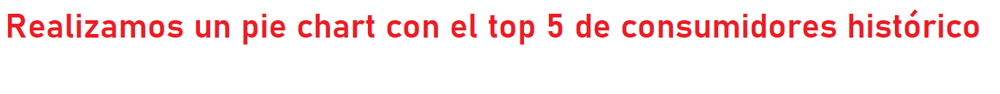

In [ ]:
df_total = df[df['Year'] <= 2020]

**Se agrupa por paises y se saca el promedio de las columnas**

In [ ]:
df_consumo = df_total.groupby('Entity').mean()

**La tabla se ordena en orden descendente en base a la columna gas consumption**

In [ ]:
df_consumo2 = df_consumo.sort_values(by='gasconsumption', ascending=False).head(6)[1:]

In [ ]:
df_consumo2[['gasconsumption']]

,gasconsumption
Entity,
United States,6.353561e+11
Russia,4.252414e+11
Germany,8.810633e+10
Canada,8.440225e+10
Iran,8.178682e+10


**Generamos el primer pie chart para visualizar los resultados obtenidos**

In [ ]:
fig = go.Figure(data=[go.Pie(labels=df_consumo2.index, values=df_consumo2['gasconsumption'],
                             marker=dict(colors=['red', 'black', 'pink', 'yellow', 'blue']))])
fig.update_layout(title='Top 5 de mayores consumidores-histórico')
fig.update_layout(margin=dict(l=30, r=30, t=40, b=40))
fig.update_layout(margin=dict(l=0, r=0),height=400)

fig.show()

En este caso, hicimos un análisis algo más acotado, vemos los 5 países con un consumo histórico de gas, es decir teniendo en cuenta más años, y como vemos, al comparar con el otro gráfico de los consumidores más actuales vemos que se repiten el primer y segundo puesto, lo que podemos concluir que, en la actualidad, los mayores dos consumidores, han sido y son, consumidores históricos, con un consumo sostenido en el tiempo, con respecto a los demás países si bien estos no lideran el podio actualmente, también se repiten en el TOP 10 del primer gráfico lo que vemos que si bien bajan algunos puestos se mantienen en el tiempo como grandes consumidores, debido a una parte por la gran población que tienen, zonas fabriles y demás factores.

#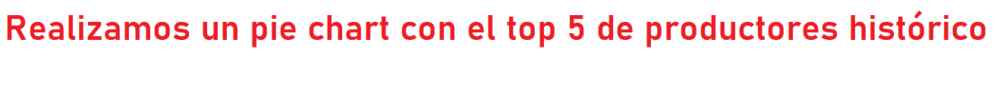

In [ ]:
df_total = df[df['Year'] <= 2020]

**Se agrupa por paises y se saca el promedio de las columnas**

In [ ]:
df_produccion = df_total.groupby('Entity').mean()

**La tabla se ordena en orden descendente en base a la columna gas production**

In [ ]:
df_produccion2 = df_produccion.sort_values(by='gasproduction', ascending=False).head(6)[1:]

In [ ]:
df_produccion2[['gasproduction']]

,gasproduction
Entity,
Russia,6.002828e+11
United States,5.853976e+11
Canada,1.460968e+11
Iran,8.263290e+10
Netherlands,7.653150e+10


**Generamos el pie chart correspondiente**

In [ ]:
fig = go.Figure(data=[go.Pie(labels=df_produccion2.index, values=df_produccion2['gasproduction'],
                             marker=dict(colors=['orange', 'red', 'green', 'teal', 'purple']))])
fig.update_layout(title='Top 5 de mayores productores-histórico')
fig.update_layout(margin=dict(l=30, r=30, t=40, b=40))
fig.update_layout(margin=dict(l=0, r=0),height=400)

fig.show()

En este TOP de países productores históricos, podemos ver, que prácticamente es el mismo ranking que los mayores productores actualmente, dando a entender, que, estos países llevan larga data de producción con cultura en desarrollar la misma, puede que la primer y segunda posición se invierta pero siguen liderando el mercado de producción del mismo.

#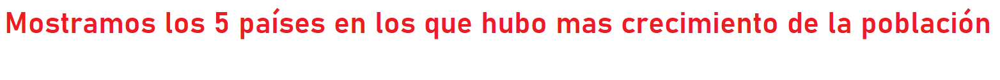

In [ ]:
df_total = df[df['Year'] <= 2020]

**Se agrupa por paises y se saca el promedio de las columnas**

In [ ]:
df_crec_pob = df_total.groupby('Entity').mean()

**La tabla se ordena en orden descendente en base a la columna population**

In [ ]:
df_crec_pob2 = df_crec_pob.sort_values(by='Population', ascending=False).head(6)[1:]

In [ ]:
df_crec_pob2[['Population']]

,Population
Entity,
China,1.258725e+09
India,1.042872e+09
United States,2.805805e+08
Indonesia,2.099325e+08
Brazil,1.706675e+08


**Con un gráfico de barras mostramos el resultado del análisis**

In [ ]:
fig = go.Figure()
fig = make_subplots(rows=2, cols=1, shared_xaxes=True)
fig.add_trace(
    go.Bar(x=df_crec_pob2.index, y=df_crec_pob2['Population'], name='Población', marker_color='red',
           text=["China", "India", "United States", "Indonesia", "Brazil"]),
    row=1, col=1)
fig.update_yaxes(title_text='Aumento de la población', row=1, col=1)
fig.update_layout(title='Top 5 paises con mayor crecimiento de la población')
fig.update_layout(
    margin=dict(l=50, r=50, t=50, b=5))
fig.update_layout(margin=dict(l=0, r=0),height=300)
fig.show()

La tabla proporciona información sobre los cinco países con mayor crecimiento poblacional en todo el mundo. Como se puede observar, China tiene la población más grande con 1.26 mil millones de personas, seguida de India con 1.04 mil millones. Ambos países tienen una población significativamente mayor que los otros tres países en la lista.

La población de los Estados Unidos es de aproximadamente 280 millones de personas, lo que representa una fracción de la población de China e India. Indonesia y Brasil también tienen poblaciones considerables, aunque son significativamente más pequeñas que las de China e India.

En general, la tabla sugiere que China e India son los países más poblados del mundo, y que su población ha seguido creciendo a lo largo de los años. La tabla también sugiere que el crecimiento de la población en los Estados Unidos, Indonesia y Brasil ha sido significativo, aunque en menor medida que en China e India.

#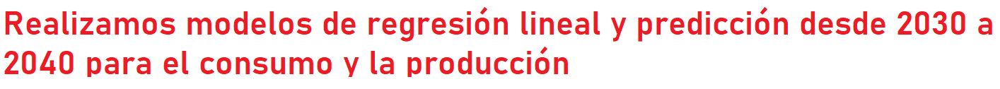

**Realizamos el análisis para la producción de gas**

In [ ]:
df_test = df[df['Entity'] == 'World']
df_test = df_test.sort_values(by='Year')

In [ ]:
y = df_test['gasproduction']
X = df_test['Year']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
X_train = np.array(X_train).reshape(-1,1)
y_train = np.array(y_train).reshape(-1,1)

In [ ]:
X_test = np.array(X_test).reshape(-1,1)
y_test = np.array(y_test).reshape(-1,1)

In [ ]:
model = LinearRegression()

In [ ]:
model.fit(X_train, y_train)

LinearRegression()

In [ ]:
y_pred = model.predict(X_test)

In [ ]:
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

In [ ]:
print('Error cuadrático medio:', mse)
print('R-cuadrado:', r2)

Error cuadrático medio: 8.388176017799812e+21
R-cuadrado: 0.9756659740033469


In [ ]:
mse_normalized = mse / (mse + r2)

En este gráfico podemos ver, cómo está entrenado nuestro modelo, a través del correspondiente código, gracias a una regresión lineal es la forma de mantener preparado el modelo para posteriores análisis y que predicción podemos llegar a hacer cuando veamos nuestras próximas conclusiones.

In [ ]:
y_train_pred = model.predict(X_train)
y_test_pred = model.predict(X_test)

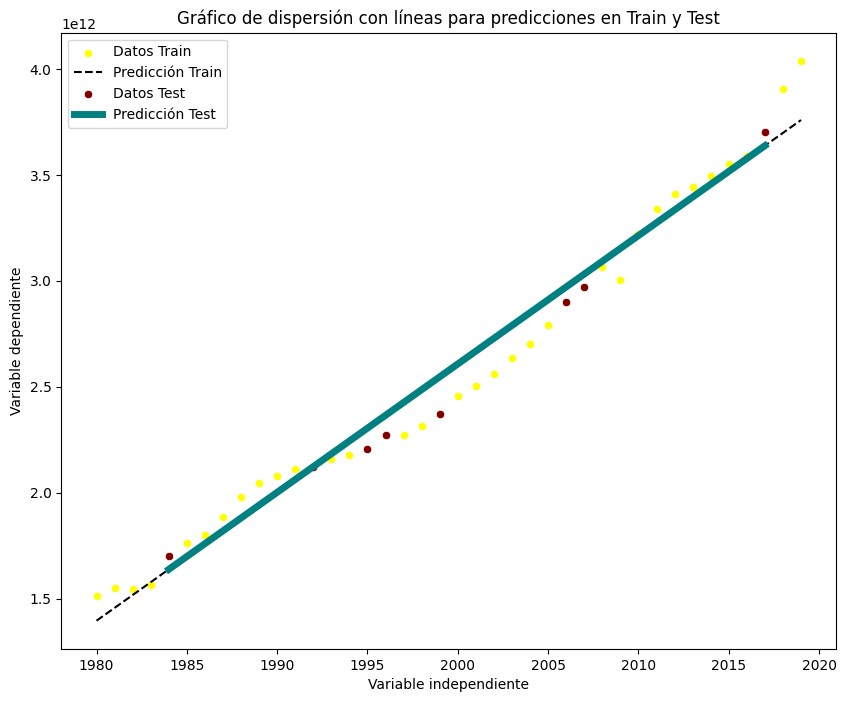

In [ ]:
X_train_array = X_train.ravel()
y_train_array = y_train.ravel()
X_test_array = X_test.ravel()
y_test_array = y_test.ravel()
y_train_pred_array = y_train_pred.ravel()
y_test_pred_array = y_test_pred.ravel()


sns.scatterplot(x=X_train_array, y=y_train_array, color='yellow', label='Datos Train')
sns.lineplot(x=X_train_array, y=y_train_pred_array, color='k', linestyle='--', label='Predicción Train')

sns.scatterplot(x=X_test_array, y=y_test_array, color='maroon', label='Datos Test')
sns.lineplot(x=X_test_array, y=y_test_pred_array, color='teal', linewidth=5.0, label='Predicción Test')


plt.xlabel('Variable independiente')
plt.ylabel('Variable dependiente')
plt.title('Gráfico de dispersión con líneas para predicciones en Train y Test')
plt.legend()


plt.show()

Aquí podemos ver nuestra predicción a través de la regresión lineal, vemos que apenas hay outliers y que, por consiguiente la predicción está bastante asimilada con respecto a los datos entrenados, es decir que puede llegar a seguir la tendencia que se viene dando para un futuro.

In [ ]:
futuro = [2030,2031,2032,2033,2034,2035,2036,2037,2038,2039,2040]

In [ ]:
for i in futuro:
    i = np.array(i).reshape(-1,1)
    prediccion = model.predict(i)
    prediccion = '{:f}'.format(float(prediccion))
    print("En el año {} se producira {}".format(int(i), prediccion))

En el año 2030 se producira 4425685378590.078125
En el año 2031 se producira 4486289817232.375000
En el año 2032 se producira 4546894255874.671875
En el año 2033 se producira 4607498694516.968750
En el año 2034 se producira 4668103133159.265625
En el año 2035 se producira 4728707571801.562500
En el año 2036 se producira 4789312010443.859375
En el año 2037 se producira 4849916449086.156250
En el año 2038 se producira 4910520887728.468750
En el año 2039 se producira 4971125326370.765625
En el año 2040 se producira 5031729765013.062500


In [ ]:
def predi (pais, año):
    df_test = df[df["Entity"] == pais]

    y = df_test['gas production']
    X = df_test['Year']


    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    X_train = np.array(X_train).reshape(-1,1)
    y_train = np.array(y_train).reshape(-1,1)

    model.fit(X_train, y_train)


    y_pred = model.predict(X_test)

    mse = mean_squared_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)

    print('Error cuadrático medio:', mse)
    print('R-cuadrado:', r2)


    prediccion = model.predict(año)

    print("En el año {} se calcula {}".format(año, prediccion))

**Realizamos el análisis para el consumo de gas**

In [ ]:
y2 = df_test['gasconsumption']
X2 = df_test['Year']

In [ ]:
X2_train, X2_test, y2_train, y2_test = train_test_split(X2, y2, test_size=0.2, random_state=42)

In [ ]:
X2_train = np.array(X2_train).reshape(-1,1)
y2_train = np.array(y2_train).reshape(-1,1)

In [ ]:
X2_test = np.array(X2_test).reshape(-1,1)
y2_test = np.array(y2_test).reshape(-1,1)

In [ ]:
model = LinearRegression()

In [ ]:
model.fit(X2_train, y2_train)

In [ ]:
y2_pred = model.predict(X2_test)

In [ ]:
mse = mean_squared_error(y2_test, y2_pred)
r2 = r2_score(y2_test, y2_pred)

In [ ]:
print('Error cuadrático medio:', mse)
print('R-cuadrado:', r2)

In [ ]:
y2_train_pred = model.predict(X2_train)
y2_test_pred = model.predict(X2_test)

In [ ]:
X2_train_array = X2_train.ravel()
y2_train_array = y2_train.ravel()
X2_test_array = X2_test.ravel()
y2_test_array = y2_test.ravel()
y2_train_pred_array = y2_train_pred.ravel()
y2_test_pred_array = y2_test_pred.ravel()


sns.scatterplot(x=X2_train_array, y=y2_train_array, color='black', label='Datos Train')
sns.lineplot(x=X2_train_array, y=y2_train_pred_array, color='k', linestyle='--', label='Predicción Train')

sns.scatterplot(x=X2_test_array, y=y2_test_array, color='pink', label='Datos Test')
sns.lineplot(x=X2_test_array, y=y2_test_pred_array, color='orange', linewidth=5.0, label='Predicción Test')


plt.xlabel('Variable independiente')
plt.ylabel('Variable dependiente')
plt.title('Gráfico de dispersión con líneas para predicciones en Train y Test')
plt.legend()


plt.show()

Aquí podemos ver nuestra predicción a través de la regresión lineal, vemos que podemos considerar un análisis parecido al de producción, es decir que seguirá en alza.

In [ ]:
futuro = [2030,2031,2032,2033,2034,2035,2036,2037,2038,2039,2040]

In [ ]:
futuro = np.array(futuro).reshape(-1,1)

In [ ]:
for i in futuro:
    i = np.array(i).reshape(-1,1)
    prediccion = model.predict(i)
    prediccion = '{:f}'.format(float(prediccion))
    print("En el año {} se consumira {}".format(int(i), prediccion))

In [ ]:
def predi (pais, año):
    df_test = df[df["Entity"] == pais]

    y2 = df_test['gasconsumption']
    X2 = df_test['Year']


    X2_train, X2_test, y2_train, y2_test = train_test_split(X2, y2, test_size=0.2, random_state=42)

    X2_train = np.array(X2_train).reshape(-1,1)
    y2_train = np.array(y2_train).reshape(-1,1)

    model.fit(X2_train, y2_train)


    y2_pred = model.predict(X2_test)

    mse = mean_squared_error(y2_test, y2_pred)
    r2 = r2_score(y2_test, y2_pred)

    print('Error cuadrático medio:', mse)
    print('R-cuadrado:', r2)


    prediccion = model.predict(año)

    print("En el año {} se calcula {}".format(año, prediccion))

Realizamos mediante un dataframe, un gráfico de lineas comparativo entre la predicción del consumo y la producción

In [ ]:
Años = [2030,2031,2032,2033,2034,2035,2036,2037,2038,2039,2040]
Prediccion_produccion = [4425685378590.078125, 4486289817232.375000, 4546894255874.671875, 4607498694516.968750, 4668103133159.265625, 4728707571801.562500,
                     4789312010443.859375, 4849916449086.156250, 4910520887728.468750, 4971125326370.765625, 5031729765013.062500]
Prediccion_consumo = [4458323705396.000000, 4519791285900.781250, 4581258866405.562500, 4642726446910.359375, 4704194027415.140625, 4765661607919.921875,
                      4827129188424.718750, 4888596768929.500000, 4950064349434.281250, 5011531929939.078125, 5072999510443.859375]

In [ ]:
Predprod = pd.DataFrame({'Años': Años, 'Cantidad': Prediccion_produccion})
Predcons = pd.DataFrame({'Años': Años, 'Cantidad': Prediccion_consumo})

In [ ]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=Predprod['Años'], y=Predprod['Cantidad'], name='Prediccion_produccion'))
fig.add_trace(go.Scatter(x=Predcons['Años'], y=Predcons['Cantidad'], name='Prediccion_consumo'))
fig.update_layout(title='Predicción producción vs consumo', xaxis_title='Años', yaxis_title='Cantidad')
fig.show()

Lo que podemos observar del gráfico, es que si bien, la producción estara en alza, definitivamente no será suficiente para suplir las necesidades futuras de la población, si continuamos con los mismos hábitos de consumo.

#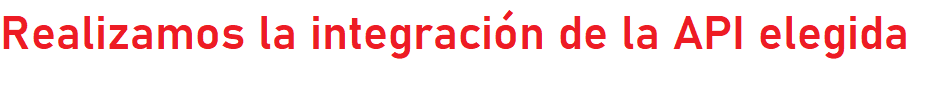

Esta API contiene los precios al contado del gas natural de Henry Hub (entro de distribución en el sistema de gasoductos de gas natural en Erath, Luisiana, propiedad de Sabine Pipe Line LLC, una subsidiaria de EnLink Midstream Partners LP que compró el activo a Chevron Corporation en 2014) diarios, semanales y mensuales. El archivo contiene datos desde el 01/01/1997 hasta el 01/06/2023.
La forma en expresar el precio es en dólares.

Fuente: Administración de Información Energética de EE. UU., Henry Hub Natural Gas Spot Price, obtenido de FRED, Banco de la Reserva Federal de St. Louis.

**Organizamos nuestro dataset original para poder realizar la integración con la API**

In [ ]:
df_filtered = df[(df['Year'] >= 1997) & (df['Year'] <= 2020)]

**Se crea una columna indice que ayude a realizar la unión del dataset original y la API**

**Se crea una columna con valores numéricos consecutivos**

In [ ]:
df_filtered['aux_index'] = range(len(df_filtered))

**Se establece la columna 'aux_index' como el índice**

In [ ]:
df_filtered = df_filtered.set_index('aux_index')

**Se muestran los primeros 10 registros para ver la nueva columna**

In [ ]:
df_filtered.head(10)

**Realizamos la carga de nuestra api en formato .json**

In [ ]:
api_url = 'https://www.alphavantage.co/query?function=NATURAL_GAS&interval=monthly&apikey=X0V1ZFY13136Q3XF'
respuesta = requests.get(api_url)
df_api = respuesta.json()
jsondata = json.loads(respuesta.text)

print(df_api)

{'name': 'Henry Hub Natural Gas Spot Price', 'interval': 'monthly', 'unit': 'dollars per million BTU', 'data': [{'date': '2023-06-01', 'value': '2.18'}, {'date': '2023-05-01', 'value': '2.15'}, {'date': '2023-04-01', 'value': '2.16'}, {'date': '2023-03-01', 'value': '2.31'}, {'date': '2023-02-01', 'value': '2.38'}, {'date': '2023-01-01', 'value': '3.27'}, {'date': '2022-12-01', 'value': '5.53'}, {'date': '2022-11-01', 'value': '5.45'}, {'date': '2022-10-01', 'value': '5.66'}, {'date': '2022-09-01', 'value': '7.88'}, {'date': '2022-08-01', 'value': '8.81'}, {'date': '2022-07-01', 'value': '7.28'}, {'date': '2022-06-01', 'value': '7.7'}, {'date': '2022-05-01', 'value': '8.14'}, {'date': '2022-04-01', 'value': '6.6'}, {'date': '2022-03-01', 'value': '4.9'}, {'date': '2022-02-01', 'value': '4.69'}, {'date': '2022-01-01', 'value': '4.38'}, {'date': '2021-12-01', 'value': '3.76'}, {'date': '2021-11-01', 'value': '5.05'}, {'date': '2021-10-01', 'value': '5.51'}, {'date': '2021-09-01', 'value'

In [ ]:
df_api= requests.get(api_url)
print (df_api)

<Response [200]>


In [ ]:
print(type(jsondata))

<class 'dict'>


In [ ]:
print(len(df_api.text))
df_api.text

26527


'{\n    "name": "Henry Hub Natural Gas Spot Price",\n    "interval": "monthly",\n    "unit": "dollars per million BTU",\n    "data": [\n        {\n            "date": "2023-06-01",\n            "value": "2.18"\n        },\n        {\n            "date": "2023-05-01",\n            "value": "2.15"\n        },\n        {\n            "date": "2023-04-01",\n            "value": "2.16"\n        },\n        {\n            "date": "2023-03-01",\n            "value": "2.31"\n        },\n        {\n            "date": "2023-02-01",\n            "value": "2.38"\n        },\n        {\n            "date": "2023-01-01",\n            "value": "3.27"\n        },\n        {\n            "date": "2022-12-01",\n            "value": "5.53"\n        },\n        {\n            "date": "2022-11-01",\n            "value": "5.45"\n        },\n        {\n            "date": "2022-10-01",\n            "value": "5.66"\n        },\n        {\n            "date": "2022-09-01",\n            "value": "7.88"\n      

In [ ]:
dictionary = jsondata
dictionary

{'name': 'Henry Hub Natural Gas Spot Price',
 'interval': 'monthly',
 'unit': 'dollars per million BTU',
 'data': [{'date': '2023-06-01', 'value': '2.18'},
  {'date': '2023-05-01', 'value': '2.15'},
  {'date': '2023-04-01', 'value': '2.16'},
  {'date': '2023-03-01', 'value': '2.31'},
  {'date': '2023-02-01', 'value': '2.38'},
  {'date': '2023-01-01', 'value': '3.27'},
  {'date': '2022-12-01', 'value': '5.53'},
  {'date': '2022-11-01', 'value': '5.45'},
  {'date': '2022-10-01', 'value': '5.66'},
  {'date': '2022-09-01', 'value': '7.88'},
  {'date': '2022-08-01', 'value': '8.81'},
  {'date': '2022-07-01', 'value': '7.28'},
  {'date': '2022-06-01', 'value': '7.7'},
  {'date': '2022-05-01', 'value': '8.14'},
  {'date': '2022-04-01', 'value': '6.6'},
  {'date': '2022-03-01', 'value': '4.9'},
  {'date': '2022-02-01', 'value': '4.69'},
  {'date': '2022-01-01', 'value': '4.38'},
  {'date': '2021-12-01', 'value': '3.76'},
  {'date': '2021-11-01', 'value': '5.05'},
  {'date': '2021-10-01', 'valu

In [ ]:
data = dictionary['data']

In [ ]:
print(data)

[{'date': '2023-06-01', 'value': '2.18'}, {'date': '2023-05-01', 'value': '2.15'}, {'date': '2023-04-01', 'value': '2.16'}, {'date': '2023-03-01', 'value': '2.31'}, {'date': '2023-02-01', 'value': '2.38'}, {'date': '2023-01-01', 'value': '3.27'}, {'date': '2022-12-01', 'value': '5.53'}, {'date': '2022-11-01', 'value': '5.45'}, {'date': '2022-10-01', 'value': '5.66'}, {'date': '2022-09-01', 'value': '7.88'}, {'date': '2022-08-01', 'value': '8.81'}, {'date': '2022-07-01', 'value': '7.28'}, {'date': '2022-06-01', 'value': '7.7'}, {'date': '2022-05-01', 'value': '8.14'}, {'date': '2022-04-01', 'value': '6.6'}, {'date': '2022-03-01', 'value': '4.9'}, {'date': '2022-02-01', 'value': '4.69'}, {'date': '2022-01-01', 'value': '4.38'}, {'date': '2021-12-01', 'value': '3.76'}, {'date': '2021-11-01', 'value': '5.05'}, {'date': '2021-10-01', 'value': '5.51'}, {'date': '2021-09-01', 'value': '5.16'}, {'date': '2021-08-01', 'value': '4.07'}, {'date': '2021-07-01', 'value': '3.84'}, {'date': '2021-06-

In [ ]:
print(type(data))

<class 'list'>


In [ ]:
df_api = pd.DataFrame(dictionary['data'])
df_api2 = pd.DataFrame(data)

**Visualizamos la información del dataset**

In [ ]:
df_api2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 318 entries, 0 to 317
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   date    318 non-null    object
 1   value   318 non-null    object
dtypes: object(2)
memory usage: 5.1+ KB


In [ ]:
print(df_api2.describe())

              date value
count          318   318
unique         318   246
top     2023-06-01  2.99
freq             1     4


**Se muestran las columnas del nuevo dataset**

In [ ]:
df_api2.columns

Index(['date', 'value'], dtype='object')

**Buscamos si existen datos nulos**

In [ ]:
print(df_api2.isnull().values.any())

False


In [ ]:
df_api2.head(10)

,date,value
0,2023-06-01,2.18
1,2023-05-01,2.15
2,2023-04-01,2.16
3,2023-03-01,2.31
4,2023-02-01,2.38
5,2023-01-01,3.27
6,2022-12-01,5.53
7,2022-11-01,5.45
8,2022-10-01,5.66
9,2022-09-01,7.88


In [ ]:
df_api2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 318 entries, 0 to 317
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   date    318 non-null    object
 1   value   318 non-null    object
dtypes: object(2)
memory usage: 5.1+ KB


**Convertimos la columna 'mes' a tipo de datos datetime**

In [ ]:
df_api2['date'] = pd.to_datetime(df_api2['date'], format='%Y-%m')

**Filtramos los datos para que la fecha esté entre 1997 y 2020**

In [ ]:
df_filtrado = df_api2[(df_api2['date'].dt.year >= 1997) & (df_api2['date'].dt.year <= 2020)]
df_filtrado = df_filtrado.reset_index()
print(df_filtrado)

     index       date  value
0       30 2020-12-01   2.59
1       31 2020-11-01   2.61
2       32 2020-10-01   2.39
3       33 2020-09-01   1.92
4       34 2020-08-01    2.3
5       35 2020-07-01   1.77
6       36 2020-06-01   1.63
7       37 2020-05-01   1.75
8       38 2020-04-01   1.74
9       39 2020-03-01   1.79
10      40 2020-02-01   1.91
11      41 2020-01-01   2.02
12      42 2019-12-01   2.22
13      43 2019-11-01   2.65
14      44 2019-10-01   2.33
15      45 2019-09-01   2.56
16      46 2019-08-01   2.22
17      47 2019-07-01   2.37
18      48 2019-06-01    2.4
19      49 2019-05-01   2.64
20      50 2019-04-01   2.65
21      51 2019-03-01   2.95
22      52 2019-02-01   2.69
23      53 2019-01-01   3.11
24      54 2018-12-01   4.04
25      55 2018-11-01   4.09
26      56 2018-10-01   3.28
27      57 2018-09-01    3.0
28      58 2018-08-01   2.96
29      59 2018-07-01   2.83
30      60 2018-06-01   2.97
31      61 2018-05-01    2.8
32      62 2018-04-01    2.8
33      63 201

**Convertimos la columna 'Columna1' de tipo object a numérico**

In [ ]:
df_filtrado['value'] = pd.to_numeric(df_filtrado['value']).rename('Value')

**Agrupamos los precios mensuales por año y calculamos el promedio**

In [ ]:
df_anual = df_filtrado.groupby(df_filtrado['date'].dt.year)['value'].mean().reset_index()
print(df_anual)

    date     value
0   1997  2.496667
1   1998  2.090833
2   1999  2.270000
3   2000  4.309167
4   2001  3.956667
5   2002  3.366667
6   2003  5.485833
7   2004  5.900000
8   2005  8.811667
9   2006  6.745000
10  2007  6.976667
11  2008  8.861667
12  2009  3.948333
13  2010  4.386667
14  2011  4.000000
15  2012  2.752500
16  2013  3.728333
17  2014  4.391667
18  2015  2.630000
19  2016  2.515000
20  2017  2.985833
21  2018  3.166667
22  2019  2.565833
23  2020  2.035000


**Se crea una columna auxiliar con valores numéricos consecutivos**

In [ ]:
df_anual['aux_index'] = range(len(df_anual))

**Se establece la columna 'aux_index' como el índice**

In [ ]:
df_anual = df_anual.set_index('aux_index')

**Se muestran las primeras 10 filas para comprobar que se haya creado la columna índice**

In [ ]:
df_anual.head(10)

,date,value
aux_index,,
0,1997,2.496667
1,1998,2.090833
2,1999,2.270000
3,2000,4.309167
4,2001,3.956667
5,2002,3.366667
6,2003,5.485833
7,2004,5.900000
8,2005,8.811667


**Se utiliza la función merge, utilizando el índice como elemento común para unir ambos dataframes**

In [ ]:
merged_df = df_filtered.merge(df_anual, left_index=True, right_index=True)

**Se muestran los primeros 10 registros para corroborar que se haya realizado la unión exitosamente**

In [ ]:
merged_df.head(10)

,Year,Entity,gasproduction,gasconsumption,Gas production per capita(m³),Gas consumption per capita(m³),Population,date,value
aux_index,,,,,,,,,
0,1997,Afghanistan,230000000.0,230000000.0,11.8800,11.8800,19360000.0,1997,2.496667
1,1998,Afghanistan,230000000.0,230000000.0,11.6500,11.6500,19740000.0,1998,2.090833
2,1999,Afghanistan,230000000.0,230000000.0,11.4000,11.4000,20170000.0,1999,2.270000
3,2000,Afghanistan,230000000.0,230000000.0,11.0700,11.0700,20780000.0,2000,4.309167
4,2001,Afghanistan,50010000.0,50010000.0,2.3140,2.3140,21610000.0,2001,3.956667
5,2002,Afghanistan,50010000.0,50010000.0,2.2130,2.2130,22600000.0,2002,3.366667
6,2003,Afghanistan,20000000.0,20000000.0,0.8447,0.8447,23680000.0,2003,5.485833
7,2004,Afghanistan,20000000.0,20000000.0,0.8089,0.8089,24730000.0,2004,5.900000
8,2005,Afghanistan,20000000.0,20000000.0,0.7797,0.7797,25650000.0,2005,8.811667


**Se muestra la información de las columnas luego de la función 'merge'**

In [ ]:
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 24 entries, 0 to 23
Data columns (total 9 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Year                            24 non-null     int64  
 1   Entity                          24 non-null     object 
 2   gasproduction                   24 non-null     float64
 3   gasconsumption                  24 non-null     float64
 4   Gas production per capita(m³)   24 non-null     float64
 5   Gas consumption per capita(m³)  24 non-null     float64
 6   Population                      24 non-null     float64
 7   date                            24 non-null     int64  
 8   value                           24 non-null     float64
dtypes: float64(6), int64(2), object(1)
memory usage: 1.9+ KB


**Se eliminan columnas que no van a ser utilizadas**

In [ ]:
col_del=['Coal consumption(Ton)','Coal production(Ton)','Oil production(m³)','Oil consumption(m³)','Oil production per capita(m³)','Coal consumption per capita(Ton)',
         'Coal production per capita(Ton)','Oil consumption per capita(m³)', 'Gas consumption per capita(m³)', 'Gas production per capita(m³)', 'Entity', 'Year']

**Se procede a eliminar las variables**

In [ ]:
merged_df=merged_df.drop(labels=col_del, axis=1)

KeyError: ignored

**Se muestran las columnas que quedaron**

In [ ]:
merged_df.columns

**Se seleccionan las columnas categóricas**

In [ ]:
col_cat= ['Population','gasconsumption','gasproduction', 'date', 'value']

**Se reemplazan los vacíos por cero**

In [ ]:
for i in col_cat:
    merged_df[i] = merged_df[i].fillna(0)

**Se verifica que no quedan datos nulos**

In [ ]:
print(merged_df.isnull().values.any())

In [ ]:
merged_df.isnull().sum()

**Se muestra la información del dataframe**

In [ ]:
merged_df.info()

**Visualizamos los primeros 10 registros**

In [ ]:
merged_df.head(10)

El aumento significativo en el precio del gas en Estados Unidos desde 2002 hasta 2009, seguido de una disminución, se debió a varios factores económicos, geopolíticos y ambientales que afectaron el mercado del gas durante ese período

**Realizamos gráficos que muestren el precio y el consumo de gas a través de los años**

In [ ]:
fig = go.Figure()

fig.add_trace(go.Bar(x=merged_df['date'], y=merged_df['value'], name='Precio anual', marker=dict(color='purple')))

fig.update_layout(
    title='Comparativa del precio entre el año 1997 hasta el año 2020',
    xaxis_title='Fecha',
    yaxis_title='Precio',
    showlegend=True,
    barmode='group'
)

fig.show()

In [ ]:
fig = go.Figure()

fig.add_trace(go.Bar(x=merged_df['date'], y=merged_df['gasconsumption'], name='Consumo de gas', marker=dict(color='red')))

fig.update_layout(
    title='Progresión anual de consumo',
    xaxis_title='Fecha',
    yaxis_title='Consumo',
    showlegend=True,
    barmode='group'
)

fig.show()

Podemos observar en los dos gráficos anteriores, que se evidencia una caída del consumo basada en el precio, ya que en los años que más aumentó el precio, fue en los que menos se consumió, y posteriormente, cuando el precio disminuyó, el consumo volvió a crecer.

#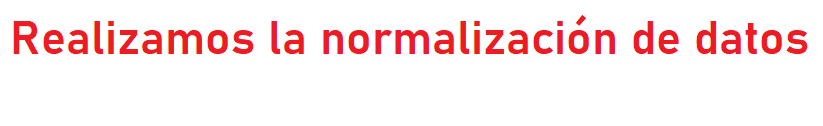

**Seleccionamos las columnas a las que aplicaremos el metodo StandardScaler**

In [ ]:
columnas_standardarizadas = ['gasconsumption', 'gasproduction', 'Population', 'Year']

**Aplicamos el StandardScaler a las columnas seleccionadas**

In [ ]:
scaler = StandardScaler()
df[columnas_standardarizadas] = scaler.fit_transform(df[columnas_standardarizadas])

**Mostramos el dataframe con las columnas normalizadas**

In [ ]:
df_head = df.head()

In [ ]:
print(df_head)

**Almacenamos las variables a utilizar en el gráfico a realizar**

In [ ]:
variables = ['gasconsumption', 'gasproduction', 'Population', 'Year']

**Realizamos el gráfico correspondiente**

In [ ]:
fig, ax = plt.subplots(figsize=(10, 6))
for variable in variables:
    ax.scatter(df[variable], df[variable], label=variable)

ax.set_xlabel('Normalized Value')
ax.set_ylabel('Normalized Value')
ax.set_title('Scatter Plot of Normalized Variables')
ax.legend()
plt.tight_layout()
plt.show()

#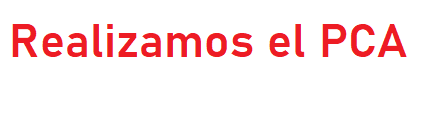

**Seleccionamos las columnas relevantes para el PCA**

In [ ]:
columnas_pca = ['gasproduction', 'gasconsumption', 'Year', 'Population']

**Aplicamos el Standar Scaler**

In [ ]:
scaler = StandardScaler()
df_scaled = scaler.fit_transform(df[columnas_pca])

**Realizamos el PCA con dos componentes principales**

In [ ]:
pca = PCA(n_components=2)
pca_result = pca.fit_transform(df_scaled)

**Creamos un nuevo dataframe con los resultados del PCA**

In [ ]:
df_pca = pd.DataFrame(data=pca_result, columns=['PC1', 'PC2'])

**Imprimimos el dataframe con los resultados del PCA**

In [ ]:
print(df_pca)

**Graficamos el resultado del PCA**

In [ ]:
plt.scatter(df_pca['PC1'], df_pca['PC2'])
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.title('PCA Scatter Plot')
plt.show()

#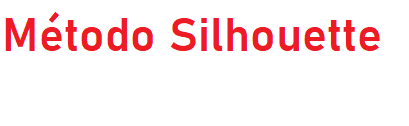

In [ ]:
X = df[['gasproduction', 'gasconsumption', 'Year', 'Population']]

n_clusters = 3

clusterer = KMeans(n_clusters=n_clusters, random_state=10)
cluster_labels = clusterer.fit_predict(X)
silhouette_coefficient = silhouette_score(X, cluster_labels)

**Imprimimos el valor del coeficiente Silhouette**

In [ ]:
print("Silhouette Coefficient:", silhouette_coefficient)

**Realizamos el gráfico correspondiente**

In [ ]:

silhouette_avg = silhouette_score(X, cluster_labels)
print("El promedio del coeficiente de Silhouette es:", silhouette_avg)

sample_silhouette_values = silhouette_samples(X, cluster_labels)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

ax1.set_xlim([-0.1, 1])
ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

y_lower = 10
for i in range(n_clusters):
    ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
    ith_cluster_silhouette_values.sort()

    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper = y_lower + size_cluster_i

    color = plt.cm.nipy_spectral(float(i) / n_clusters)
    ax1.fill_betweenx(np.arange(y_lower, y_upper), 0, ith_cluster_silhouette_values,
                      facecolor=color, edgecolor=color, alpha=0.7)

    ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
    y_lower = y_upper + 10

ax1.set_title("Gráfico de Silhouette para {} clusters".format(n_clusters))
ax1.set_xlabel("Coeficiente de Silhouette")
ax1.set_ylabel("Cluster Label")

ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

colors = plt.cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)

ax2.scatter(X['Year'], X['gasproduction'], c=colors, edgecolor='k')
ax2.scatter(clusterer.cluster_centers_[:, 2], clusterer.cluster_centers_[:, 0],
            marker='x', color='red', s=200, label='Centroids')
ax2.set_xlabel("Year")
ax2.set_ylabel("gasproduction")
ax2.set_title("Gráfico de dispersión con centroides")

plt.tight_layout()
plt.show()

En este caso, un valor de 0.5706 para el promedio del coeficiente de Silhouette indica que los clusters tienen una separación razonablemente buena. Esto significa que las muestras dentro de cada cluster están más cerca entre sí en comparación con las muestras de otros clusters, y hay una buena distancia entre los clusters.

#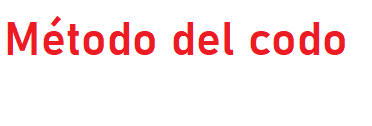

In [ ]:
#Se seleccionan las variables a utilizar
X = df[['gasproduction', 'gasconsumption', 'Year', 'Population']]

# Rango de número de clusters para probar
range_n_clusters = [2, 3, 4, 5, 6, 7, 8, 9, 10]

# Lista para almacenar las sumas de las distancias al cuadrado
sum_of_squared_distances = []

for n_clusters in range_n_clusters:
    # Ajustar el modelo de clustering
    kmeans = KMeans(n_clusters=n_clusters, random_state=10)
    kmeans.fit(X)

    # Obtener la suma de las distancias al cuadrado
    sum_of_squared_distances.append(kmeans.inertia_)

# Graficar la curva de la suma de las distancias al cuadrado
plt.plot(range_n_clusters, sum_of_squared_distances, 'bx-')
plt.xlabel('Número de clusters')
plt.ylabel('Suma de las distancias al cuadrado')
plt.title('Método del codo')
plt.show()

Según el "método del codo", la cantidad de clústers sugerida, es de 3 clúster, como se puede observar en el gráfico, que es donde se produce el primer "quiebre" dentro del gráfico lineal

#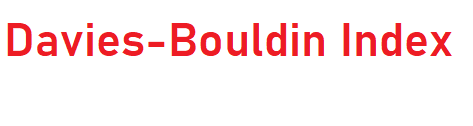

In [ ]:
db = {}
for k in range(2, 10):
    kmeans = KMeans(n_clusters=k, max_iter=1000,random_state=10).fit(X)
    if k == 3: labels = kmeans.labels_
    clusters = kmeans.labels_
    db[k] = davies_bouldin_score(X,clusters)

In [ ]:
plt.figure(figsize=(10,8))
plt.plot(list(db.keys()), list(db.values()))
plt.xlabel("Numero de clusters")
plt.ylabel("Indice Davies-Bouldin")
plt.show()

Según este método, la primer variacion en el gráfico de lineas en el número de cluster 3, aunque también puede ser interpretado como que otra opción sea la de 4 clusters

#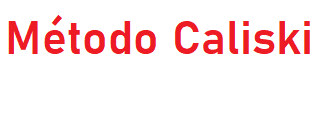

In [ ]:
def calinski_harabasz_index(X, labels):
    return calinski_harabasz_score(X, labels)

In [ ]:
X = df[['gasproduction', 'gasconsumption', 'Year', 'Population']]
labels = kmeans.labels_

In [ ]:
ch_index = calinski_harabasz_index(X, labels)
print("Índice de Calinski-Harabasz:", ch_index)

Esto indica que los puntos dentro de cada cluster están muy cercanos entre sí y los clusters están bien separados entre sí en el espacio de características

#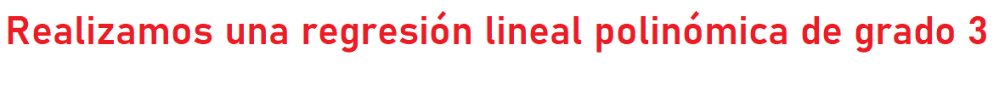

Se introdujo una regresión polinómica para explorar posibles relaciones no lineales entre la población, el año, el consumo y la producción. Esta elección se justifica por la necesidad de capturar patrones más complejos y evaluar interacciones entre variables. Además, la regresión polinómica permite un ajuste más preciso a los datos cuando existe una relación no lineal significativa.
Con la información obtenida luego de realizar los índices correspondientes, decidimos aplicar una regresión polinómica de grado 3 como sugerían los análisis realizados

**Definimos las variables**

In [ ]:
X = df[['Year', 'gasproduction', 'gasconsumption']]
y = df['Population']

**Indicamos el grado de polinomio a utilizar**

In [ ]:
poly_features = PolynomialFeatures(degree=3)

**Definimos las variables y entrenamos el modelo**

In [ ]:
X_poly = poly_features.fit_transform(X)

In [ ]:
model = make_pipeline(LinearRegression())

In [ ]:
model.fit(X_poly, y)

In [ ]:
X_poly = poly_features.transform(X)

In [ ]:
y_pred = cross_val_predict(model, X_poly, y, cv=5)

**Visualizamos el MSE score**

In [ ]:
mse_scores = -cross_val_score(model, X_poly, y, scoring='neg_mean_squared_error', cv=5)

In [ ]:
mean_mse = np.mean(mse_scores)
std_mse = np.std(mse_scores)

print("Mean MSE:", mean_mse)
print("Std MSE:", std_mse)

#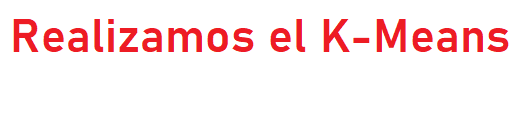

**Definimos la cantidad de clusters**

In [ ]:
kmeans = KMeans(n_clusters=3)

**Entrenamos el modelo k-means**

In [ ]:
kmeans.fit(X)

In [ ]:
cluster_labels = kmeans.labels_

**Localizamos los centroides*

In [ ]:
centroids = kmeans.cluster_centers_

**Realizamos un scatter que muestre los resultados obtenidos**

In [ ]:
plt.scatter(X['Year'], X['gasproduction'], c=cluster_labels)
plt.scatter(centroids[:, 0], centroids[:, 1], marker='x', color='red', s=200, label='Centroids')
plt.xlabel('Year')
plt.ylabel('gasproduction')
plt.title('K-means Clustering')

plt.legend()
plt.show()

**Definimos las variables**

In [ ]:
X = df[['Year', 'gasproduction', 'gasconsumption']]
y = df['Population']

**Indicamos el grado de polinomio a utilizar**

In [ ]:
poly_features = PolynomialFeatures(degree=3)

**Definimos las variables y entrenamos el modelo**

In [ ]:
X_poly = poly_features.fit_transform(X)

In [ ]:
model = make_pipeline(LinearRegression())

In [ ]:
model.fit(X_poly, y)

In [ ]:
X_poly = poly_features.transform(X)

In [ ]:
y_pred = cross_val_predict(model, X_poly, y, cv=5)

In [ ]:
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(12, 4))
axes[0].scatter(df['Year'], y, color='blue')
axes[0].set_xlabel('Year')
axes[0].set_ylabel('Population')
axes[0].set_title('Year vs Population')
axes[1].scatter(df['gasproduction'], y, color='green')
axes[1].set_xlabel('gasproduction')
axes[1].set_ylabel('Population')
axes[1].set_title('gasproduction vs Population')
axes[2].scatter(df['gasconsumption'], y, color='red')
axes[2].set_xlabel('gasconsumption')
axes[2].set_ylabel('Population')
axes[2].set_title('gasconsumption vs Population')

plt.tight_layout()

plt.show()

**Visualizamos el MSE score**

In [ ]:
mse_scores = -cross_val_score(model, X_poly, y, scoring='neg_mean_squared_error', cv=5)

In [ ]:
mean_mse = np.mean(mse_scores)
std_mse = np.std(mse_scores)

print("Mean MSE:", mean_mse)
print("Std MSE:", std_mse)

#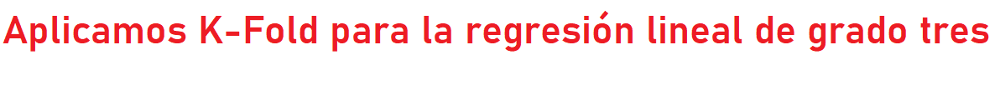

**Creamos el objeto K-Fold**

In [ ]:
kfold = KFold(n_splits=5)

**Realizamos la validación cruzada**

In [ ]:
scores = cross_val_score(model, X_poly, y, cv=kfold)

**Visualizamos los resultados de la validación cruzada**


In [ ]:
print("Puntuaciones de validación cruzada: ", scores)

**Visualizamos los resultados del Error cuadrático medio**

In [ ]:
print("Error cuadrático medio medio: ", -scores.mean())

Conclusión: el hecho de tener valores muy negativos en el K-fold puede ser indicativo de un problema en el ajuste del modelo o una posible anomalía en los datos, teniendo en cuenta que el análisis de nulos, duplicados y atípicos, se descarta la anomalía de los datos, lo cual puede sugerir un problema con el ajuste del modelo y que quizas, el grado polinomial, no sea el adecuado, sumado a esto, el resultado del error cuadrático medio, indica que las predicciones están bastante alejadas de los valores reales de las etiquetas. Por todo lo explicado anteriormente, se considera realizar una regresión polinómica de grado dos para ver como se ajusta el modelo.

#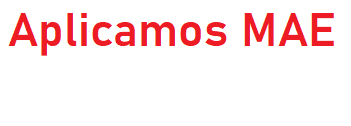

**Calculamos las predicciones del modelo**

In [ ]:
y_pred = model.predict(X_poly)

**Calculamos la MAE**

In [ ]:
mae = mean_absolute_error(y, y_pred)

**Mostramos el valor del índice**

In [ ]:
print("MAE:", mae)

En este caso, según el valor de MAE de 0.0791220217682532 significa que, en promedio, las predicciones del modelo difieren en 0.0791 unidades de los valores reales. Esto indica que el modelo tiene un buen rendimiento en términos de precisión, ya que el error promedio es bastante bajo.

#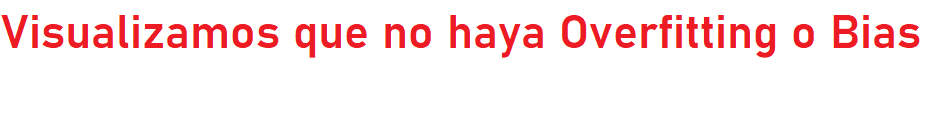

**Utilizamos una validación cruzada, dividiendo los datos en 5 folds, en las que se entrena el modelo en algunas particiones y evalúa su rendimiento en las restantes**

In [ ]:
y_pred = cross_val_predict(model, X_poly, y, cv=5)

**Calculamos el MSE entre las predicciones y los valores reales**

In [ ]:
mse = mean_squared_error(y, y_pred)

**Calculamos el MSE en el conjunto de entrenamiento**

In [ ]:
y_train_pred = model.predict(X_poly)
mse_train = mean_squared_error(y, y_train_pred)

**Mostramos los resultados**

In [ ]:
print("MSE en el conjunto de prueba:", mse)
print("MSE en el conjunto de entrenamiento:", mse_train)

**Realizamos un gráfico para visualizar los valores reales vs las predicciones**

In [ ]:
plt.scatter(y, y_pred)
plt.plot([y.min(), y.max()], [y.min(), y.max()], 'k--', lw=2)
plt.xlabel('Valores reales')
plt.ylabel('Predicciones')
plt.title('Valores reales vs Predicciones')
plt.show()

El MSE en el conjunto de prueba es de 25312.396886789673. Esto significa que, en promedio, las predicciones del modelo en el conjunto de prueba difieren, en términos de error al cuadrado, en aproximadamente 25312.4 unidades con respecto a los valores reales. El MSE en el conjunto de entrenamiento es de 0.0659407160379971. Un MSE tan bajo en el conjunto de entrenamiento podría indicar un ajuste excesivo del modelo a los datos de entrenamiento. En nuestro caso hay una gran diferencia entre el MSE en el conjunto de entrenamiento y el MSE en el conjunto de prueba,lo que puede indicar un overfitting

#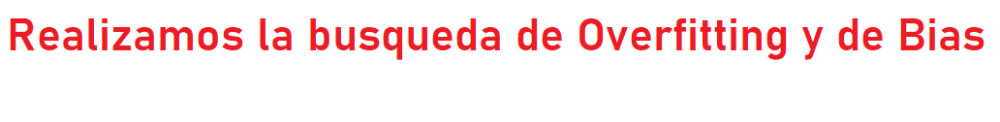

Dividimos el conjunto de datos en entrenamiento y prueba, reduciendo el tamaño

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.5, random_state=42)

Seleccionamos solo las variables relevantes para la regresión lineal polinómica

In [ ]:
X_relevant = X[['gasproduction', 'gasconsumption', 'Year']]

Se divide el conjunto de datos relevante en entrenamiento y prueba, reduciendo el tamaño

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X_relevant, y, test_size=0.5, random_state=42)

Se define el modelo con PolynomialFeatures y LinearRegression

In [ ]:
model = make_pipeline(PolynomialFeatures(), StandardScaler(), LinearRegression())

Se definen los hiperparámetros a ajustar, poniendo posibles valores para el grado de polinomio, y valores posibles para el ajuste de la intersección

In [ ]:
parameters = {'polynomialfeatures__degree': [2, 3],
    'linearregression__fit_intercept': [True, False]}

Se crea el objeto GridSearchCV

In [ ]:
grid_search = GridSearchCV(model, parameters, cv=5, scoring='neg_mean_squared_error')

Realizamos la búsqueda de hiperparámetros

In [ ]:
grid_search.fit(X_poly, y)

Obtenemos los mejores hiperparámetros y el mejor modelo

In [ ]:
best_params = grid_search.best_params_
best_model = grid_search.best_estimator_

Mostramos los mejores hiperparámetros encontrados

In [ ]:
print("Mejores hiperparámetros:", best_params)

Evaluamos el rendimiento del mejor modelo en el conjunto de prueba

In [ ]:
y_pred = best_model.predict(X_poly)
mse = mean_squared_error(y, y_pred)
print("Error cuadrático medio en el conjunto de prueba:", mse)

Conclusión: en este caso, se indica el mejor valor encontrado para los hiperparámetros durante la búsqueda, lo que significa que se ajustará una intersección en el modelo de regresión lineal. Además, se encontró que el mejor valor para el hiperparámetro de grado polinomial es 2, con lo cual, nos concentraremos en poner a prueba lo sugerido, para poder comprobar fehacientemente que sea la mejor opción.

#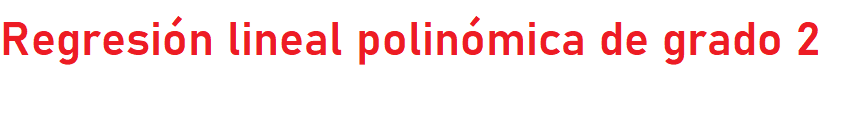

Teniendo en cuenta la búsqueda de los mejores hiperparámetros, el resultado de grado de polinomio 2, indica que será una mejor opción para una regresión lineal, y en este momento, vamos a poner a prueba el resultado

**Definimos las variables**

In [ ]:
X = df[['Year', 'gasproduction', 'gasconsumption']]
y = df['Population']

**Indicamos el grado de polinomio a utilizar**

In [ ]:
poly_features = PolynomialFeatures(degree=2)

**Definimos las variables y entrenamos el modelo**

In [ ]:
X_poly = poly_features.fit_transform(X)

In [ ]:
model = make_pipeline(LinearRegression())

In [ ]:
model.fit(X_poly, y)

In [ ]:
X_poly = poly_features.transform(X)

In [ ]:
y_pred = cross_val_predict(model, X_poly, y, cv=5)

In [ ]:
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(12, 4))
axes[0].scatter(df['Year'], y, color='teal')
axes[0].set_xlabel('Year')
axes[0].set_ylabel('Population')
axes[0].set_title('Year vs Population')
axes[1].scatter(df['gasproduction'], y, color='brown')
axes[1].set_xlabel('gasproduction')
axes[1].set_ylabel('Population')
axes[1].set_title('gasproduction vs Population')
axes[2].scatter(df['gasconsumption'], y, color='purple')
axes[2].set_xlabel('gasconsumption')
axes[2].set_ylabel('Population')
axes[2].set_title('gasconsumption vs Population')

plt.tight_layout()

plt.show()

**Visualizamos el MSE score**

In [ ]:
mse_scores = -cross_val_score(model, X_poly, y, scoring='neg_mean_squared_error', cv=5)

In [ ]:
mean_mse = np.mean(mse_scores)
std_mse = np.std(mse_scores)

print("Mean MSE:", mean_mse)
print("Std MSE:", std_mse)

En este caso, realizando la regresión lineal polinómica, pero de grado 2, podemos observar que el valor del Mean MSE, indica que el modelo tiene un mejor ajuste a los datos y, por lo tanto, es más preciso en sus predicciones. Por otro lado, un Std MSE más bajo indica que los errores del modelo son más consistentes y menos variables.

#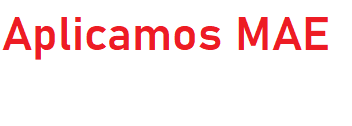

**Calculamos las predicciones del modelo**

In [ ]:
y_pred = model.predict(X_poly)

**Calculamos la MAE**

In [ ]:
mae = mean_absolute_error(y, y_pred)

**Mostramos el valor del índice**

In [ ]:
print("MAE:", mae)

En este caso, según el valor de MAE de 0.0853801642157823 significa que, en promedio, las predicciones del modelo difieren en 0.085 unidades de los valores reales. Esto indica que el modelo tiene un buen rendimiento en términos de precisión, ya que el error promedio es bastante bajo.

#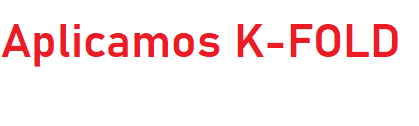

**Creamos el objeto K-Fold**

In [ ]:
kfold = KFold(n_splits=5)

**Realizamos la validación cruzada**

In [ ]:
scores = cross_val_score(model, X_poly, y, cv=kfold)

**Visualizamos los resultados de la validación cruzada**


In [ ]:
print("Puntuaciones de validación cruzada: ", scores)

En este caso, las puntuaciones del score varían desde aprox -5.121 hasta
-0.013, lo que indica que el rango de ajuste del modelo es bastante bueno en los diferentes folds de la validación cruzada

**Visualizamos los resultados del Error cuadrático medio**

In [ ]:
print("Error cuadrático medio medio: ", -scores.mean())

Este valor nos indica que, en promedio, las predicciones del modelo tienen un error cuadrático medio moderado y, que las predicciones, están relativamente cerca de los valores reales de las etiquetas, pero aún existe cierta discrepancia entre ellos

#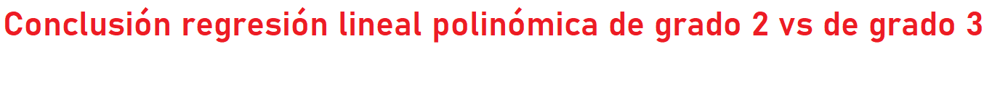

El análisis de la regresión polinómica de grado tres, como indicaba el análisis realizado con el método Silhouette, del codo, Calinski y el Davies-Bouldin Index, cuando fue puesto a prueba para ver si había overfitting o Bias, resultó que cuando se realizó la busca de mejor modelo e hiperparámetros, dió como resultado una regresión lineal polinómica, pero de grado dos, lo cual fue realizada en este análisis. Teniendo en cuenta lo mencionado anteriormente, los resultados obtenidos de la validación cruzada con el método K-Fold sugieren que el modelo de regresión lineal polinómica de grado 2 puede tener dificultades para ajustarse adecuadamente a los datos en algunos casos, lo que resulta en puntuaciones de validación cruzada variables y un error cuadrático medio moderado. Lo explicado, lleva a considerar que por más que el hiperparámetro sugiriera un grado menor de polinomio, lo mejor es optar por realizar la regresión lineal con grado tres

Los resultados obtenidos de la regresión polinómica revelaron efectos no lineales y posibles interacciones entre las variables. Esto proporciona una visión más completa de cómo el consumo, la producción y el año influyen en la variación de la población


#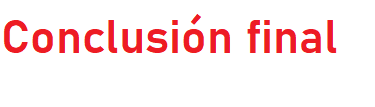

**Adicionalmente a los filtros aplicados para poder llegar a conclusiones concretas sobre el dataset seleccionado, se realizó un análisis sobre la variación de la población, consumo y producción de gas en diferentes países a lo largo de los años. Se aplicaron regresiones lineales para estudiar las relaciones entre el consumo y el año, así como entre la producción y el año. Estas regresiones proporcionaron predicciones iniciales.**

**Además, se utilizó una regresión polinómica para capturar posibles relaciones no lineales entre las variables y explorar interacciones. La regresión polinómica permitió ajustar mejor el modelo a los datos y obtener una comprensión más detallada de las relaciones entre la población, el consumo, la producción y el año.**

**Los resultados de la regresión polinómica revelaron efectos no lineales significativos y proporcionaron una visión más completa del comportamiento de las variables. Esto permitió realizar predicciones más precisas y detalladas sobre el crecimiento poblacional futuro.**

**En resumen, la regresión polinómica enriqueció el análisis al capturar relaciones no lineales y explorar interacciones entre las variables, lo que condujo a predicciones más precisas y una comprensión más completa de los factores que influyen en la variación de la población, consumo y producción de gas.**

**Según el análisis realizado las conclusiones que podemos destacar,
son:**
* **El consumo de un recurso natural está determinado por la
disponibilidad que hay en un país, junto con factores económicos y
demográficos.**
* **Los países más ricos son los que mayor capacidad de consumo
tienen, ya que, si no poseen disponibilidad en su territorio, pueden
adquirirlo mediante comercio con países que si posean.**
* **A futuro, el consumo de gas sobrepasará la cantidad que se extraiga.**
* **Es imperioso, como sociedad, que busquemos otras formas de
energía, que sean renovables, con el fin de que no ocurra un
desabastecimiento masivo de forma intempestiva. La inversión en
energías tales como la nuclear, eólica, hídrica y solar es necesaria,
para desarrollar métodos de obtención mas eficientes y económicos,
con el fin de que llegado el momento de que el gas no sea mas un
recurso a utilizar, sea mas simple como sociedad, tener acceso a
estos.**